In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [ ]:
data_path = 'Crop_recommendation.csv'
data = pd.read_csv(data_path)
data= data.drop_duplicates()

In [ ]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2200 entries, 0 to 2199
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   N            2200 non-null   int64  
 1   P            2200 non-null   int64  
 2   K            2200 non-null   int64  
 3   temperature  2200 non-null   float64
 4   humidity     2200 non-null   float64
 5   ph           2200 non-null   float64
 6   rainfall     2200 non-null   float64
 7   label        2200 non-null   object 
dtypes: float64(4), int64(3), object(1)
memory usage: 137.6+ KB
None


In [ ]:
classification_dict = {
    'rice': 'AC', 'maize': 'AC', 'chickpea': 'AC', 'kidneybeans': 'AC',
    'pigeonpeas': 'AC', 'mothbeans': 'AC', 'mungbean': 'AC', 'blackgram': 'AC',
    'lentil': 'AC', 'pomegranate': 'HC', 'banana': 'HC', 'mango': 'HC',
    'grapes': 'HC', 'watermelon': 'HC', 'muskmelon': 'AC', 'apple': 'HC',
    'orange': 'HC', 'papaya': 'HC', 'coconut': 'HC', 'cotton': 'AC',
    'jute': 'AC', 'coffee': 'HC'
}

data['crop_category'] = data['label'].map(classification_dict)

In [ ]:
mean_rainfall = data[data['crop_category'].isin(['AC', 'HC'])].groupby('crop_category')['rainfall'].mean()
print('RAINFALL')
print(mean_rainfall)
print()

mean_N = data[data['crop_category'].isin(['AC', 'HC'])].groupby('crop_category')['N'].mean()
print('N')
print(mean_N)
print()

mean_P = data[data['crop_category'].isin(['AC', 'HC'])].groupby('crop_category')['P'].mean()
print('P')
print(mean_P)
print()


mean_K = data[data['crop_category'].isin(['AC', 'HC'])].groupby('crop_category')['K'].mean()
print('k')
print(mean_K)
print()


RAINFALL
crop_category
AC     95.785992
HC    112.676851
Name: rainfall, dtype: float64

N
crop_category
AC    53.0775
HC    47.5210
Name: N, dtype: float64

P
crop_category
AC    53.418333
HC    53.296000
Name: P, dtype: float64

k
crop_category
AC    30.691667
HC    69.098000
Name: K, dtype: float64



In [ ]:
mean_temperature = data[data['crop_category'].isin(['AC', 'HC'])].groupby('crop_category')['temperature'].mean()
print('temperature')
print(mean_temperature)
print()

mean_humidity = data[data['crop_category'].isin(['AC', 'HC'])].groupby('crop_category')['humidity'].mean()
print('humidity')
print(mean_humidity)
print()

mean_ph = data[data['crop_category'].isin(['AC', 'HC'])].groupby('crop_category')['ph'].mean()
print('ph')
print(mean_ph)

temperature
crop_category
AC    25.135143
HC    26.193565
Name: temperature, dtype: float64

humidity
crop_category
AC    62.85852
HC    81.82969
Name: humidity, dtype: float64

ph
crop_category
AC    6.597706
HC    6.315609
Name: ph, dtype: float64


In [ ]:
unique_values = data['label'].unique()

print(unique_values)
value_counts = data['crop_category'].value_counts()

print(value_counts)


distinct_counts = data['label'].value_counts().value_counts()



['rice' 'maize' 'chickpea' 'kidneybeans' 'pigeonpeas' 'mothbeans'
 'mungbean' 'blackgram' 'lentil' 'pomegranate' 'banana' 'mango' 'grapes'
 'watermelon' 'muskmelon' 'apple' 'orange' 'papaya' 'coconut' 'cotton'
 'jute' 'coffee']
crop_category
AC    1200
HC    1000
Name: count, dtype: int64


In [ ]:
ac_data = data[data['crop_category'] == 'AC']
hc_data = data[data['crop_category'] == 'HC']
co_data = data


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns


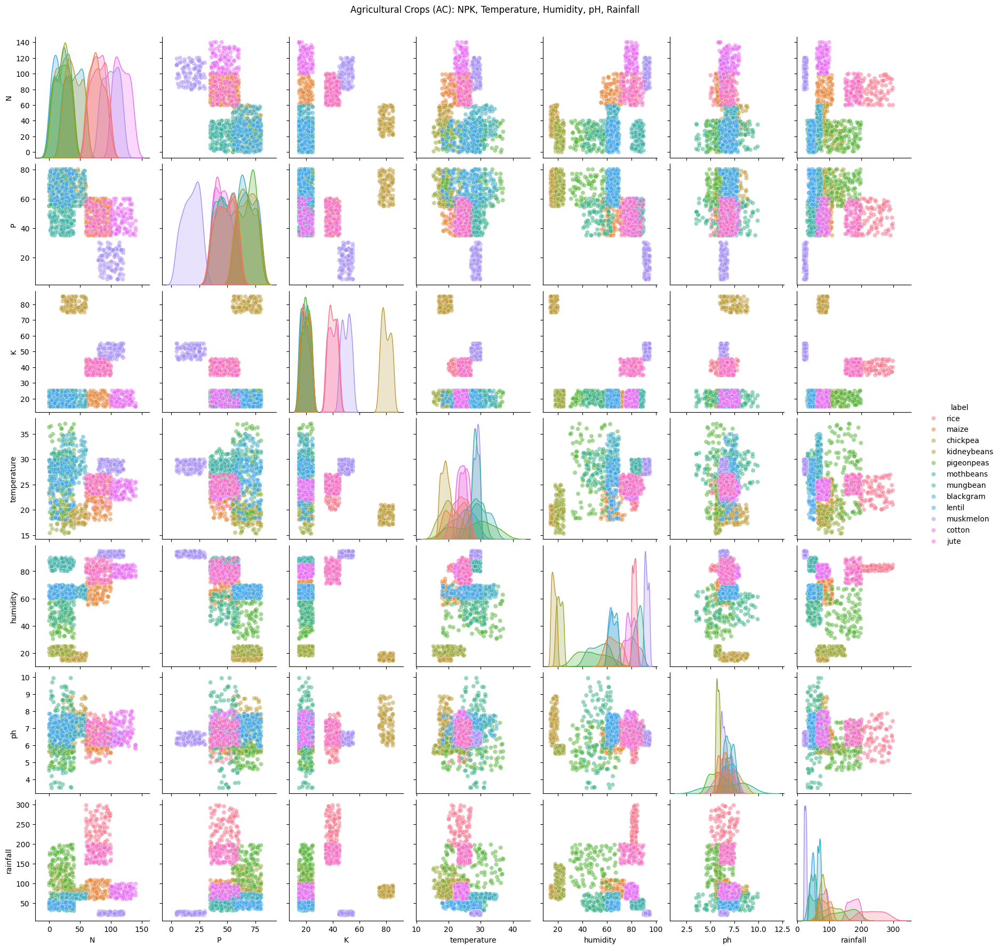

In [ ]:
sns.pairplot(ac_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label']],
             diag_kind="kde",
             hue='label',
             plot_kws={'alpha': 0.5})

plt.suptitle('Agricultural Crops (AC): NPK, Temperature, Humidity, pH, Rainfall', y=1.02)
plt.show()

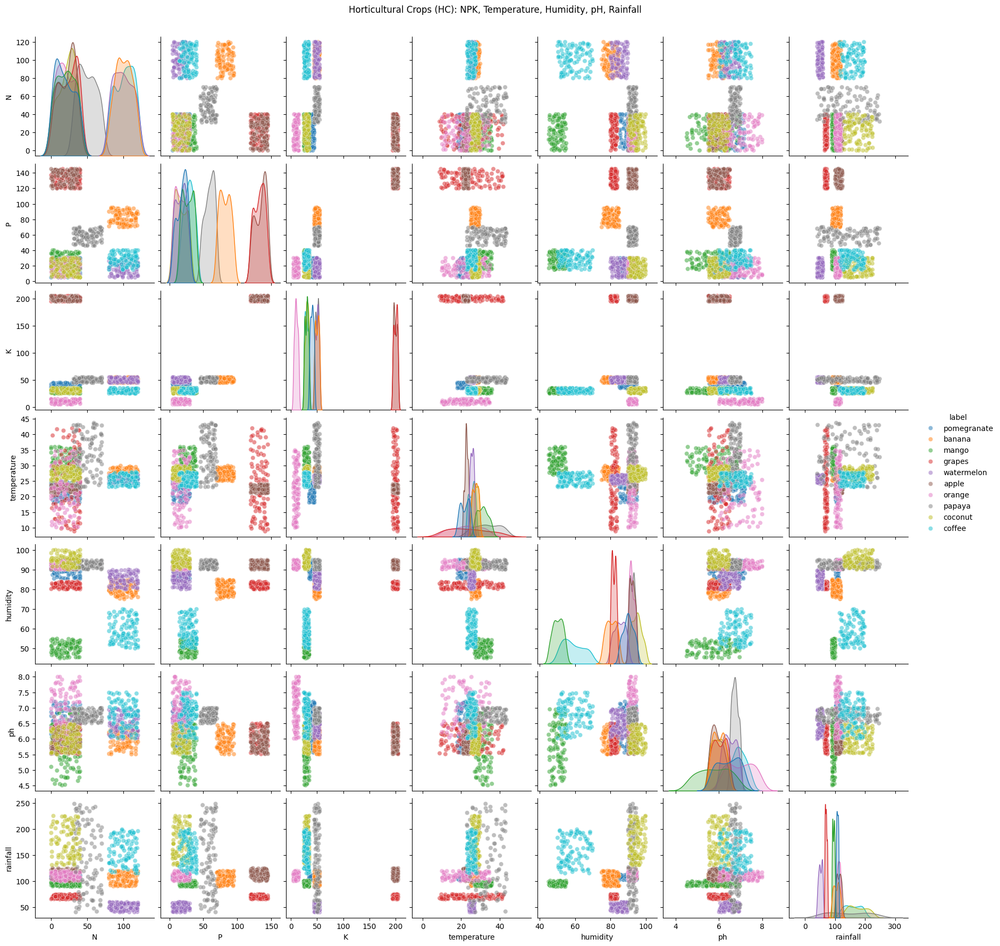

In [ ]:
sns.pairplot(hc_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label']],
             diag_kind="kde",
             hue='label',
             plot_kws={'alpha': 0.5})
plt.suptitle('Horticultural Crops (HC): NPK, Temperature, Humidity, pH, Rainfall', y=1.02)
plt.show()


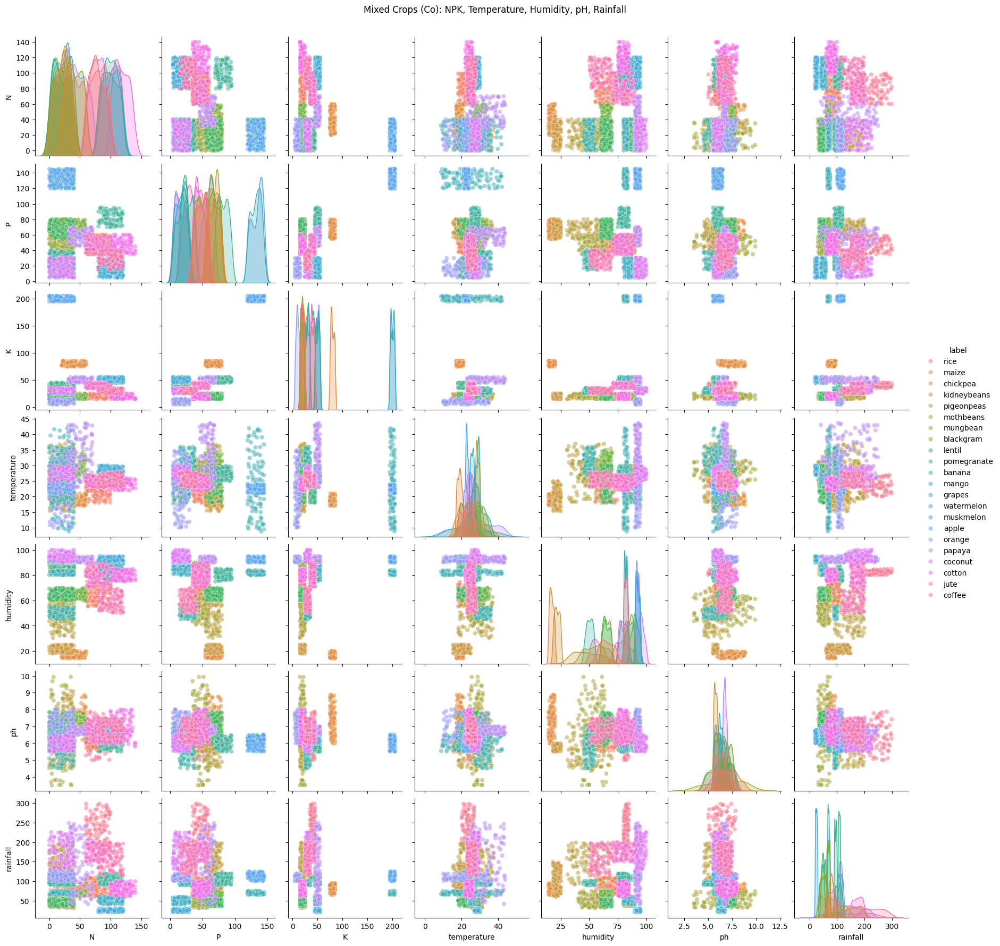

In [ ]:
sns.pairplot(co_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label']],
             diag_kind="kde",
             hue='label',
             plot_kws={'alpha': 0.5})
plt.suptitle('Mixed Crops (Co): NPK, Temperature, Humidity, pH, Rainfall', y=1.02)
plt.show()


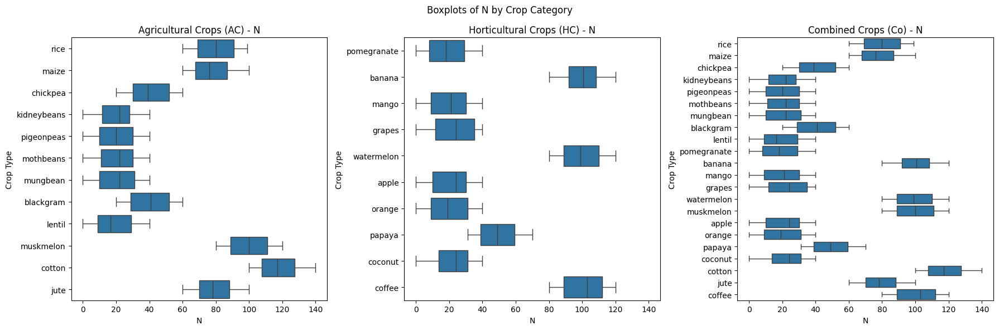

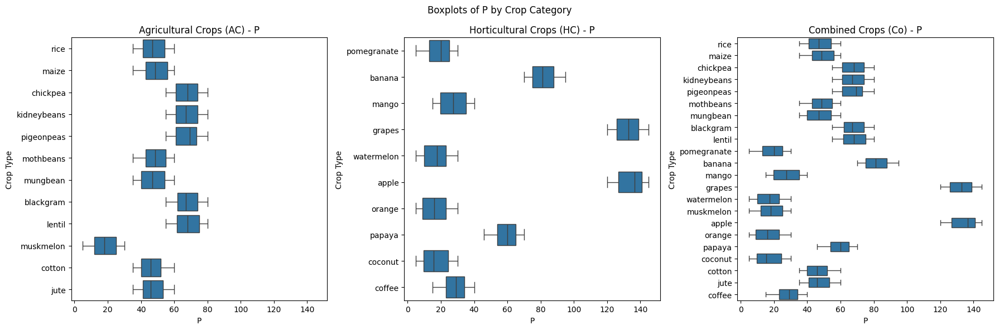

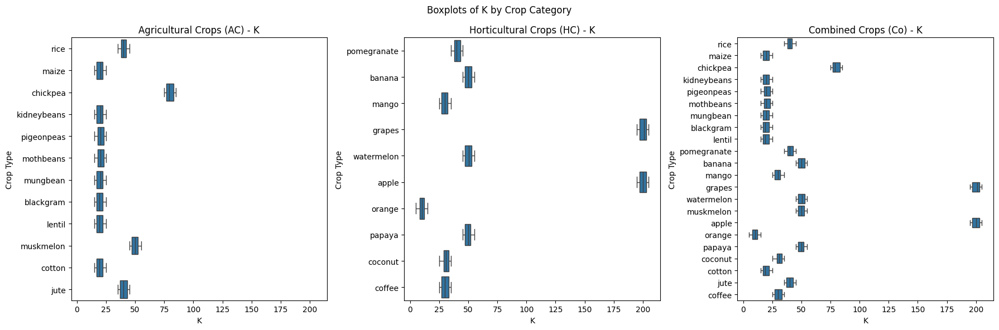

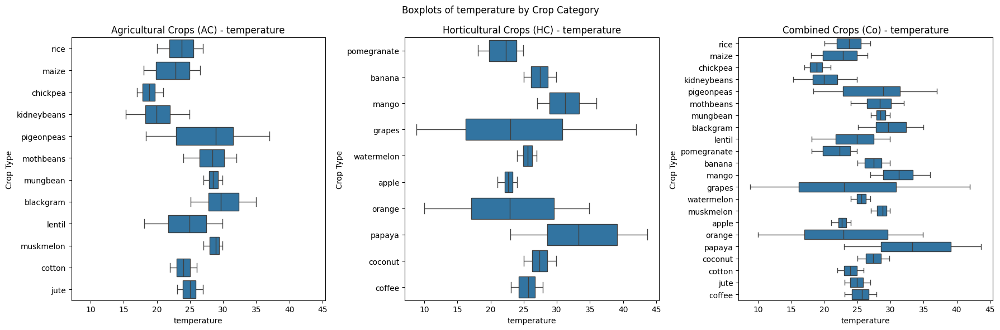

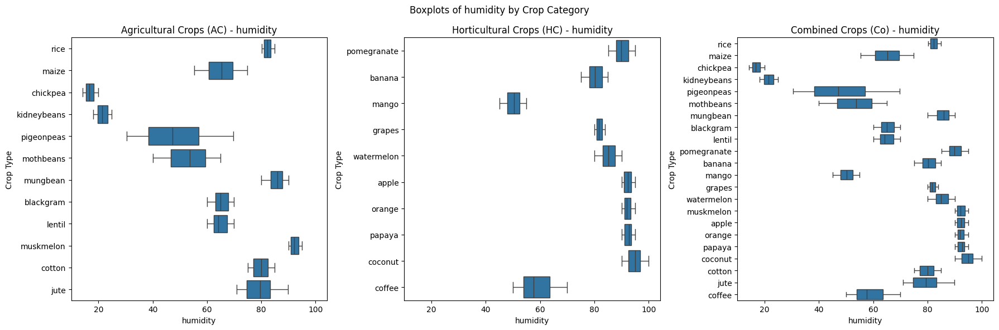

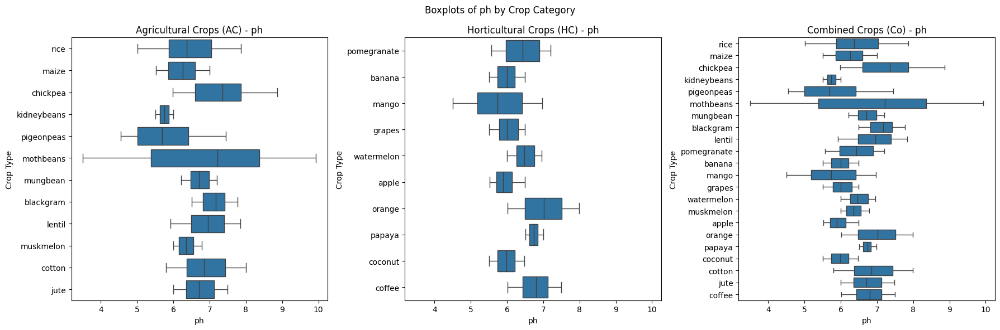

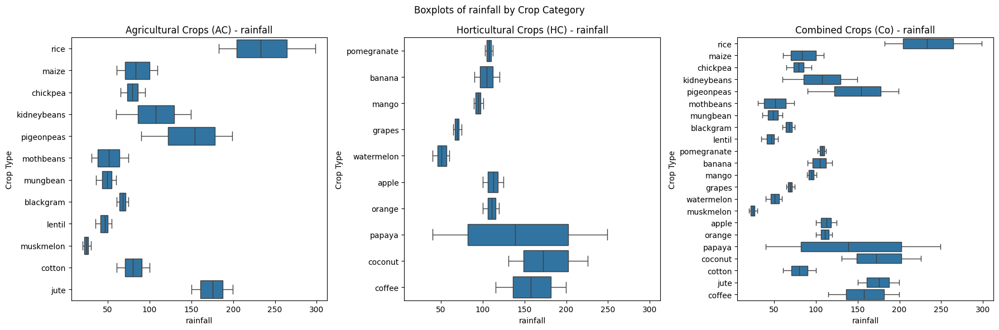

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

columns_to_plot = ['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']

for col in columns_to_plot:
    fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharex=True)
    fig.suptitle(f'Boxplots of {col} by Crop Category')

    # Boxplot for agricultural crops (AC)
    sns.boxplot(y='label', x=col, data=ac_data, ax=axes[0])
    axes[0].set_title(f'Agricultural Crops (AC) - {col}')
    axes[0].set_ylabel('Crop Type')
    axes[0].set_xlabel(col)

    # Boxplot for horticultural crops (HC)
    sns.boxplot(y='label', x=col, data=hc_data, ax=axes[1])
    axes[1].set_title(f'Horticultural Crops (HC) - {col}')
    axes[1].set_ylabel('Crop Type')
    axes[1].set_xlabel(col)

    # Boxplot for combined crops (Co)
    sns.boxplot(y='label', x=col, data=co_data, ax=axes[2])
    axes[2].set_title(f'Combined Crops (Co) - {col}')
    axes[2].set_ylabel('Crop Type')
    axes[2].set_xlabel(col)

    plt.tight_layout()
    plt.show()


In [ ]:
X_ac = ac_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']]
y_ac = ac_data['label']
X_hc = hc_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']]
y_hc = hc_data['label']
X_co = co_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']]
y_co = co_data['label']



# Encoding labels if they are categorical
label_encoder_ac = LabelEncoder()
label_encoder_hc = LabelEncoder()
label_encoder_co = LabelEncoder()

y_ac_encoded = label_encoder_ac.fit_transform(y_ac)
y_hc_encoded = label_encoder_hc.fit_transform(y_hc)
y_co_encoded = label_encoder_co.fit_transform(y_co)

In [ ]:

X_train_ac, X_test_ac, y_train_ac, y_test_ac = train_test_split(X_ac, y_ac_encoded, test_size=0.3, random_state=2)

X_train_hc, X_test_hc, y_train_hc, y_test_hc = train_test_split(X_hc, y_hc_encoded, test_size=0.3, random_state=2)

X_train_co, X_test_co, y_train_co, y_test_co = train_test_split(X_co, y_co_encoded, test_size=0.3, random_state=2)

In [ ]:
pip install xgboost

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier

def evaluate_model(model, X_train, X_test, y_train, y_test):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    return {
        "Accuracy": accuracy_score(y_test, y_pred) * 100,
        "Precision": precision_score(y_test, y_pred, average='weighted') * 100,
        "Recall": recall_score(y_test, y_pred, average='weighted') * 100,
        "F1-score": f1_score(y_test, y_pred, average='weighted') * 100
    }

rf_params = {'n_estimators': 15, 'max_depth': 6, 'max_features': 5, 'random_state': 0,'min_samples_split': 4}
dt_params = {'criterion': 'entropy', 'max_depth': 5, 'random_state': 2,'ccp_alpha': 0.001}
svm_params = {'C': 5, 'kernel': 'linear', 'gamma': 0.1}
xgb_params = {'learning_rate': 0.1, 'max_depth': 17, 'n_estimators': 200, 'subsample': 0.5, 'gamma': 0, 'seed': 50}
knn_params = {'n_neighbors': 3, 'metric': 'minkowski'}

# Initializing models with respective hyperparameters
models = {
    'RF': RandomForestClassifier(**rf_params),
    'DT': DecisionTreeClassifier(**dt_params),
    'SVM': SVC(**svm_params,probability=True),
    'XGBoost': XGBClassifier(**xgb_params),
    'KNN': KNeighborsClassifier(**knn_params)
}

X_train_ac, X_test_ac, y_train_ac, y_test_ac = train_test_split(X_ac, y_ac_encoded, test_size=0.3, random_state=2)
X_train_hc, X_test_hc, y_train_hc, y_test_hc = train_test_split(X_hc, y_hc_encoded, test_size=0.3, random_state=2)
X_train_co, X_test_co, y_train_co, y_test_co = train_test_split(X_co, y_co_encoded, test_size=0.3, random_state=2)

results = {"Model": [], "Accuracy_AC": [], "Accuracy_HC": [], "Accuracy_Co": [],
           "Precision_AC": [], "Precision_HC": [], "Precision_Co": [],
           "Recall_AC": [], "Recall_HC": [], "Recall_Co": [],
           "F1_AC": [], "F1_HC": [], "F1_Co": []}

for model_name, model in models.items():
    ac_metrics = evaluate_model(model, X_train_ac, X_test_ac, y_train_ac, y_test_ac)

    hc_metrics = evaluate_model(model, X_train_hc, X_test_hc, y_train_hc, y_test_hc)

    co_metrics = evaluate_model(model, X_train_co, X_test_co, y_train_co, y_test_co)

    results["Model"].append(model_name)
    results["Accuracy_AC"].append(ac_metrics["Accuracy"])
    results["Accuracy_HC"].append(hc_metrics["Accuracy"])
    results["Accuracy_Co"].append(co_metrics["Accuracy"])

    results["Precision_AC"].append(ac_metrics["Precision"])
    results["Precision_HC"].append(hc_metrics["Precision"])
    results["Precision_Co"].append(co_metrics["Precision"])

    results["Recall_AC"].append(ac_metrics["Recall"])
    results["Recall_HC"].append(hc_metrics["Recall"])
    results["Recall_Co"].append(co_metrics["Recall"])

    results["F1_AC"].append(ac_metrics["F1-score"])
    results["F1_HC"].append(hc_metrics["F1-score"])
    results["F1_Co"].append(co_metrics["F1-score"])

results_df = pd.DataFrame(results)
print(results_df)


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


     Model  Accuracy_AC  Accuracy_HC  Accuracy_Co  Precision_AC  Precision_HC  \
0       RF    98.611111   100.000000    98.181818     98.730070    100.000000   
1       DT    94.722222   100.000000    85.909091     95.555801    100.000000   
2      SVM    98.055556   100.000000    98.333333     98.190436    100.000000   
3  XGBoost    96.111111    99.666667    99.090909     96.462415     99.677778   
4      KNN    97.222222   100.000000    98.030303     97.385019    100.000000   

   Precision_Co  Recall_AC   Recall_HC  Recall_Co      F1_AC       F1_HC  \
0     98.521297  98.611111  100.000000  98.181818  98.609772  100.000000   
1     80.434694  94.722222  100.000000  85.909091  94.731107  100.000000   
2     98.337925  98.055556  100.000000  98.333333  98.044925  100.000000   
3     99.115387  96.111111   99.666667  99.090909  96.101984   99.666667   
4     98.062387  97.222222  100.000000  98.030303  97.213244  100.000000   

       F1_Co  
0  98.157089  
1  81.108815  
2  98.33317

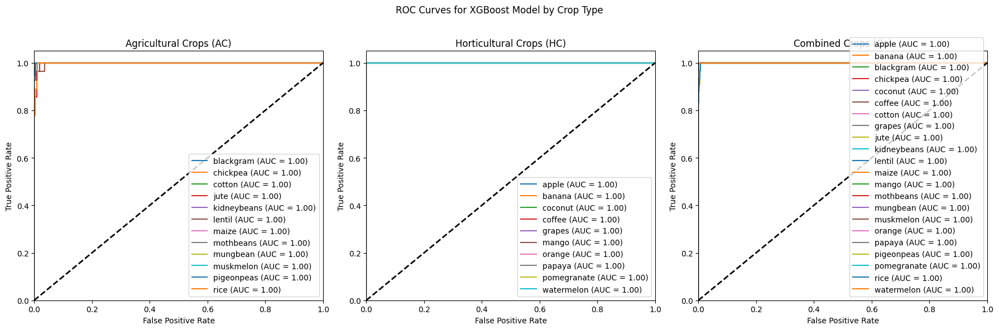

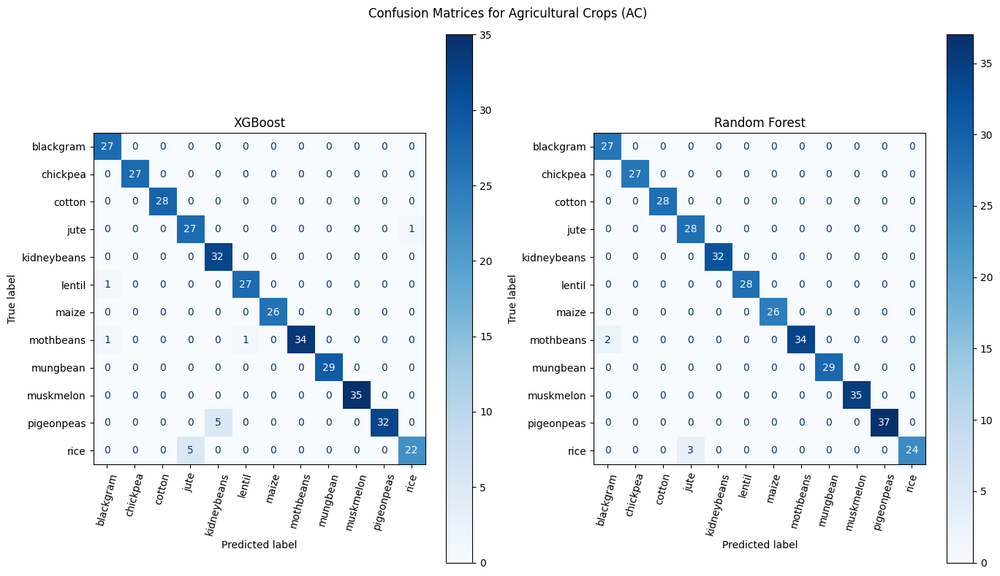

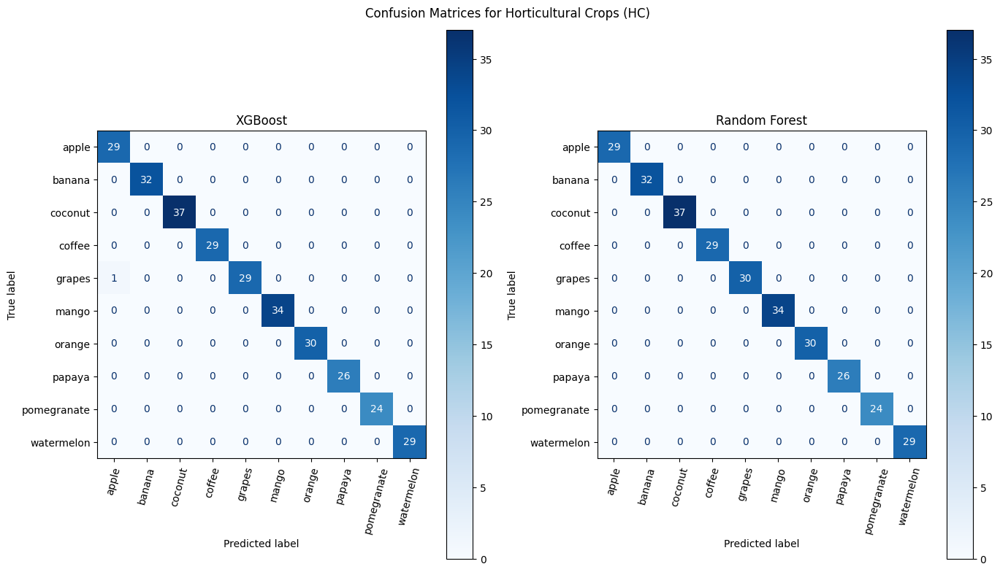

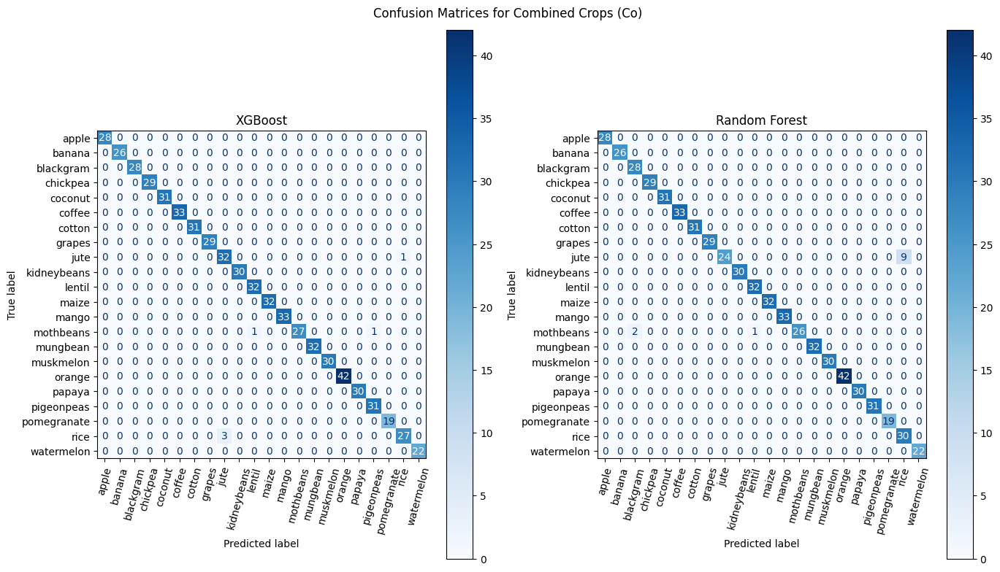

In [ ]:
from sklearn.metrics import roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize, LabelEncoder
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score

def plot_roc_curve_per_class(model, X_test, y_test, title, label_encoder, ax):
    y_test_binarized = label_binarize(y_test, classes=range(len(label_encoder.classes_)))
    y_score = model.predict_proba(X_test)

    for i in range(len(label_encoder.classes_)):
        fpr, tpr, _ = roc_curve(y_test_binarized[:, i], y_score[:, i])
        roc_auc = auc(fpr, tpr)
        ax.plot(fpr, tpr, label=f'{label_encoder.inverse_transform([i])[0]} (AUC = {roc_auc:.2f})')

    ax.plot([0, 1], [0, 1], 'k--', lw=2)
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title(title)
    ax.legend(loc="lower right")

xgb_model_ac = XGBClassifier(**xgb_params)
xgb_model_hc = XGBClassifier(**xgb_params)
xgb_model_co = XGBClassifier(**xgb_params)
rf_model_ac = RandomForestClassifier(**rf_params)
rf_model_hc = RandomForestClassifier(**rf_params)
rf_model_co = RandomForestClassifier(**rf_params)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle("ROC Curves for XGBoost Model by Crop Type")

# Agricultural Crops (AC)
xgb_model_ac.fit(X_train_ac, y_train_ac)
plot_roc_curve_per_class(xgb_model_ac, X_test_ac, y_test_ac, "Agricultural Crops (AC)", label_encoder_ac, axes[0])

# Horticultural Crops (HC)
xgb_model_hc.fit(X_train_hc, y_train_hc)
plot_roc_curve_per_class(xgb_model_hc, X_test_hc, y_test_hc, "Horticultural Crops (HC)", label_encoder_hc, axes[1])

# Combined Crops (Co)
xgb_model_co.fit(X_train_co, y_train_co)
plot_roc_curve_per_class(xgb_model_co, X_test_co, y_test_co, "Combined Crops (Co)", label_encoder_co, axes[2])

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# Confusion matrices for each crop category using XGBoost and Random Forest
def plot_confusion_matrix(model, X_test, y_test, title, label_encoder, ax):
    y_pred = label_encoder.inverse_transform(model.predict(X_test))
    ConfusionMatrixDisplay.from_predictions(label_encoder.inverse_transform(y_test), y_pred, ax=ax, cmap='Blues')
    ax.set_title(title)
    ax.tick_params(axis='x', rotation=75)

# Agricultural Crops (AC)
fig, axes = plt.subplots(1, 2, figsize=(14, 8))
fig.suptitle("Confusion Matrices for Agricultural Crops (AC)")

# XGBoost
plot_confusion_matrix(xgb_model_ac, X_test_ac, y_test_ac, "XGBoost", label_encoder_ac, axes[0])

# Random Forest
rf_model_ac.fit(X_train_ac, y_train_ac)
plot_confusion_matrix(rf_model_ac, X_test_ac, y_test_ac, "Random Forest", label_encoder_ac, axes[1])

plt.tight_layout()
plt.show()

# Horticultural Crops (HC)
fig, axes = plt.subplots(1, 2, figsize=(14, 8))
fig.suptitle("Confusion Matrices for Horticultural Crops (HC)")

# XGBoost
plot_confusion_matrix(xgb_model_hc, X_test_hc, y_test_hc, "XGBoost", label_encoder_hc, axes[0])

# Random Forest
rf_model_hc.fit(X_train_hc, y_train_hc)
plot_confusion_matrix(rf_model_hc, X_test_hc, y_test_hc, "Random Forest", label_encoder_hc, axes[1])

plt.tight_layout()
plt.show()

# Combined Crops (Co)
fig, axes = plt.subplots(1, 2, figsize=(14, 8))
fig.suptitle("Confusion Matrices for Combined Crops (Co)")

# XGBoost
plot_confusion_matrix(xgb_model_co, X_test_co, y_test_co, "XGBoost", label_encoder_co, axes[0])

# Random Forest
rf_model_co.fit(X_train_co, y_train_co)
plot_confusion_matrix(rf_model_co, X_test_co, y_test_co, "Random Forest", label_encoder_co, axes[1])

plt.tight_layout()
plt.show()


In [ ]:
!pip install lime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 11.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=acce06f14c76b509d59f29a6fffe28c7a4c043894edbcce68d72084111577886
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from lime.lime_tabular import LimeTabularExplainer


print("For AC")
def explain_model_with_lime(model, model_name, X_train, y_train, X_test, label_encoder):
    lime_explainer = LimeTabularExplainer(
        training_data=X_train.values,
        training_labels=y_train,
        feature_names=X_train.columns.tolist(),
        class_names=label_encoder.classes_,
        discretize_continuous=True
    )

    test_instance = X_test.iloc[0].values

    def safe_predict_proba(input_data):
        if len(input_data.shape) == 1:
            input_data = input_data.reshape(1, -1)
        return model.predict_proba(input_data)

    lime_exp = lime_explainer.explain_instance(
        data_row=test_instance,
        predict_fn=safe_predict_proba
    )

    lime_exp.show_in_notebook(show_table=True, show_all=False)
    lime_exp.save_to_file(f'lime_explanation_{model_name}.html')


for model_name, model in models.items():
    print(model_name)
    if model_name in ['RF','DT', 'SVM', 'XGBoost', 'KNN']:

        X_train_data = X_train_ac
        y_train_data = y_train_ac
        X_test_data = X_test_ac
        label_encoder_data = label_encoder_ac


    explain_model_with_lime(model, model_name, X_train_data, y_train_data, X_test_data, label_encoder_data)


For AC
RF


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


DT


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


SVM


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(


XGBoost


KNN


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


In [ ]:
from lime.lime_tabular import LimeTabularExplainer


print("For HC")
def explain_model_with_lime(model, model_name, X_train, y_train, X_test, label_encoder):
    lime_explainer = LimeTabularExplainer(
        training_data=X_train.values,
        training_labels=y_train,
        feature_names=X_train.columns.tolist(),
        class_names=label_encoder.classes_,
        discretize_continuous=True
    )

    test_instance = X_test.iloc[0].values

    def safe_predict_proba(input_data):
        if len(input_data.shape) == 1:
            input_data = input_data.reshape(1, -1)
        return model.predict_proba(input_data)

    lime_exp = lime_explainer.explain_instance(
        data_row=test_instance,
        predict_fn=safe_predict_proba
    )

    lime_exp.show_in_notebook(show_table=True, show_all=False)
    lime_exp.save_to_file(f'lime_explanation_{model_name}.html')


for model_name, model in models.items():

    if model_name in ['RF','DT', 'SVM', 'XGBoost', 'KNN']:
        X_train_data = X_train_hc
        y_train_data = y_train_hc
        X_test_data = X_test_hc
        label_encoder_data = label_encoder_hc


    explain_model_with_lime(model, model_name, X_train_data, y_train_data, X_test_data, label_encoder_data)


For HC


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


In [ ]:
from lime.lime_tabular import LimeTabularExplainer


print("For Co")
def explain_model_with_lime(model, model_name, X_train, y_train, X_test, label_encoder):
    lime_explainer = LimeTabularExplainer(
        training_data=X_train.values,
        training_labels=y_train,
        feature_names=X_train.columns.tolist(),
        class_names=label_encoder.classes_,
        discretize_continuous=True
    )

    test_instance = X_test.iloc[0].values

    def safe_predict_proba(input_data):
        if len(input_data.shape) == 1:
            input_data = input_data.reshape(1, -1)
        return model.predict_proba(input_data)

    lime_exp = lime_explainer.explain_instance(
        data_row=test_instance,
        predict_fn=safe_predict_proba
    )

    lime_exp.show_in_notebook(show_table=True, show_all=False)
    lime_exp.save_to_file(f'lime_explanation_{model_name}.html')

for model_name, model in models.items():

    if model_name in ['RF','DT', 'SVM', 'XGBoost', 'KNN']:
        X_train_data = X_train_co
        y_train_data = y_train_co
        X_test_data = X_test_co
        label_encoder_data = label_encoder_co

    explain_model_with_lime(model, model_name, X_train_data, y_train_data, X_test_data, label_encoder_data)


For Co


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


In [ ]:
pip install shap


For Random Forest on AC


ExactExplainer explainer: 361it [00:10,  3.76it/s]                         


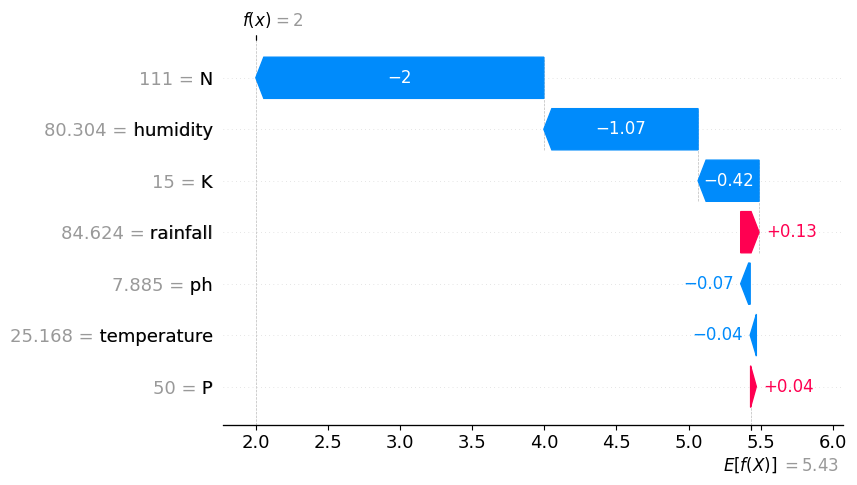

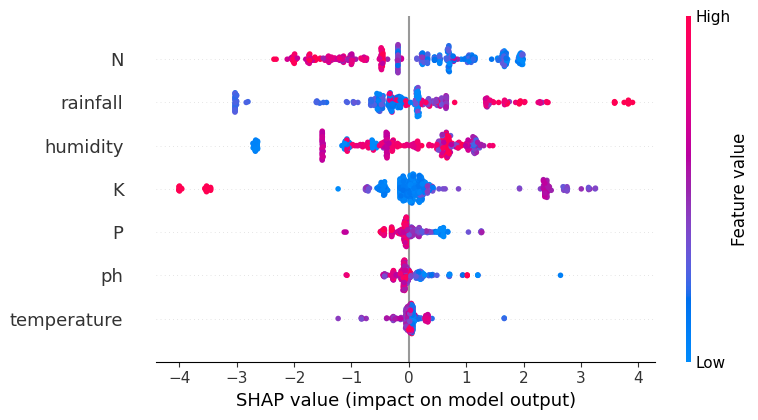

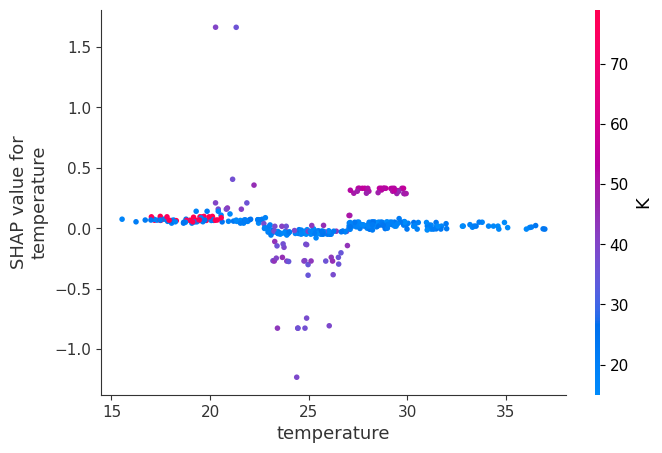

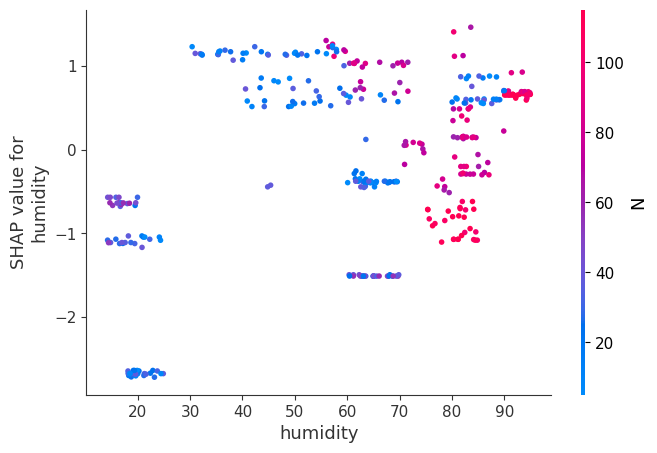

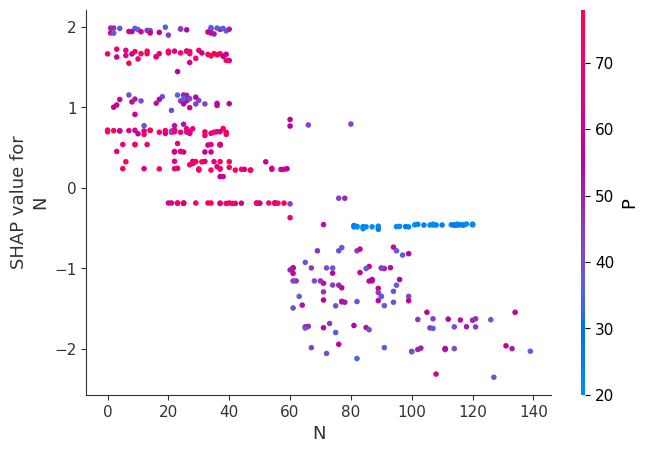

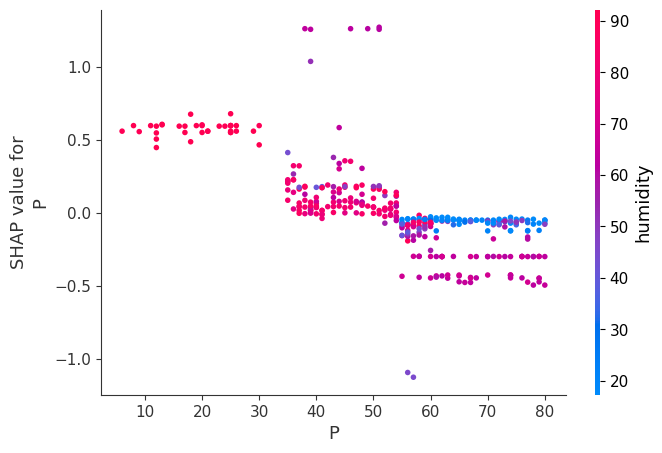

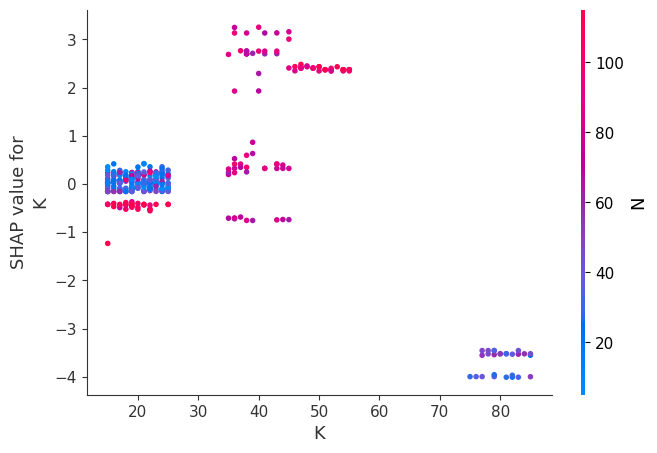

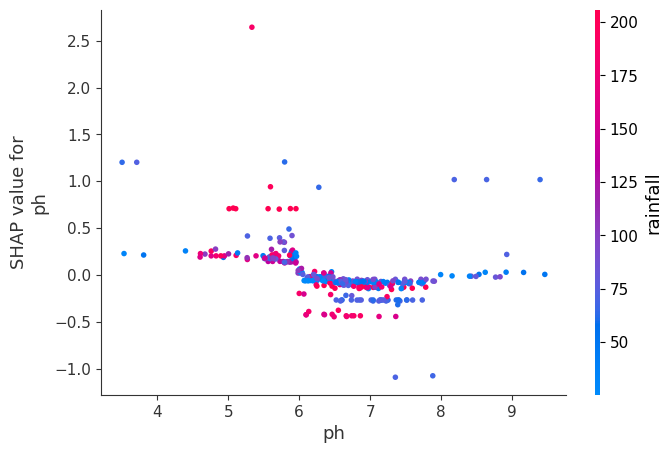

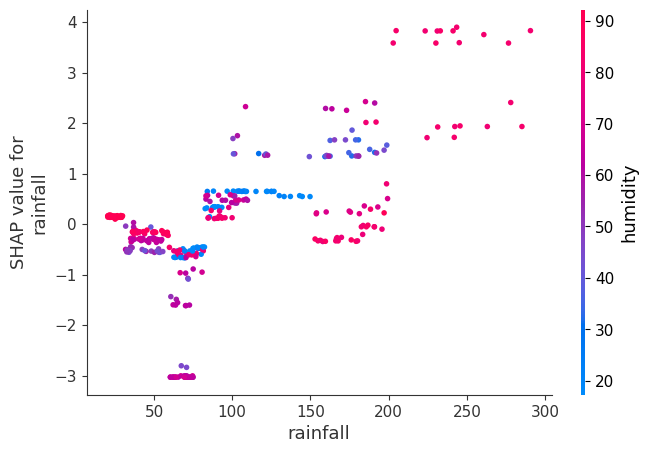

In [ ]:
import shap

print("For Random Forest on AC")
model_rf = models['RF']
model_rf.fit(X_train_ac, y_train_ac)

shap_explainer = shap.Explainer(model_rf.predict, X_train_ac)

shap_values = shap_explainer(X_test_ac)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])

shap.summary_plot(shap_values, X_test_ac)

shap.dependence_plot("temperature", shap_values_array, X_test_ac)
shap.dependence_plot("humidity", shap_values_array, X_test_ac)
shap.dependence_plot("N", shap_values_array, X_test_ac)
shap.dependence_plot("P", shap_values_array, X_test_ac)
shap.dependence_plot("K", shap_values_array, X_test_ac)
shap.dependence_plot("ph", shap_values_array, X_test_ac)
shap.dependence_plot("rainfall", shap_values_array, X_test_ac)

For Decision Tree on AC


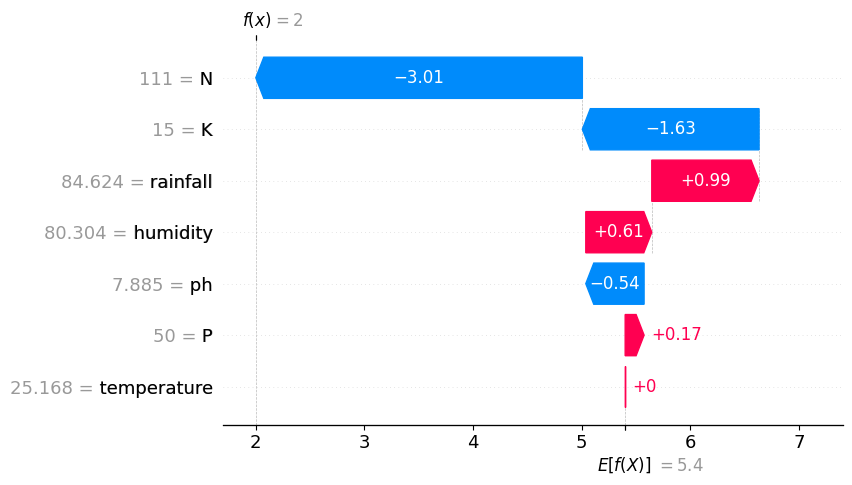

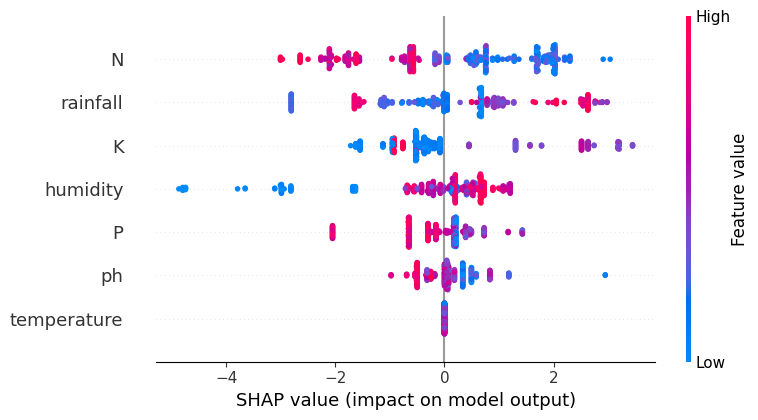

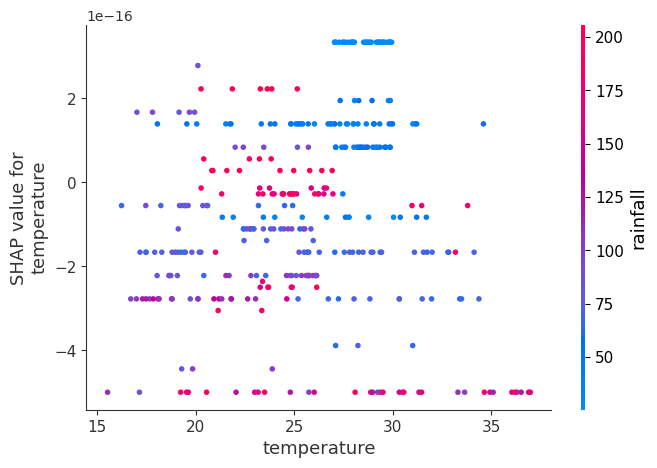

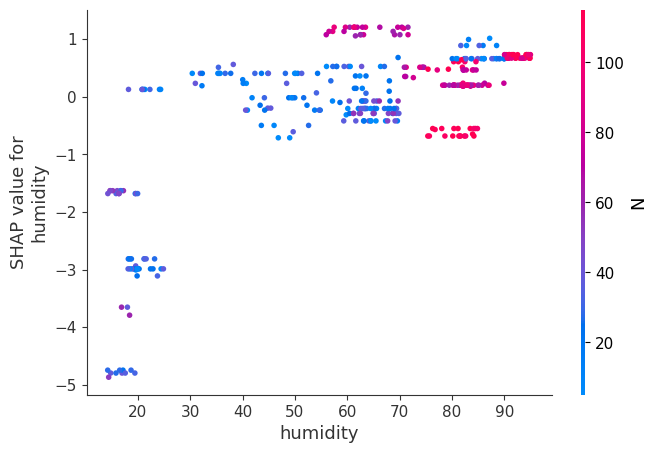

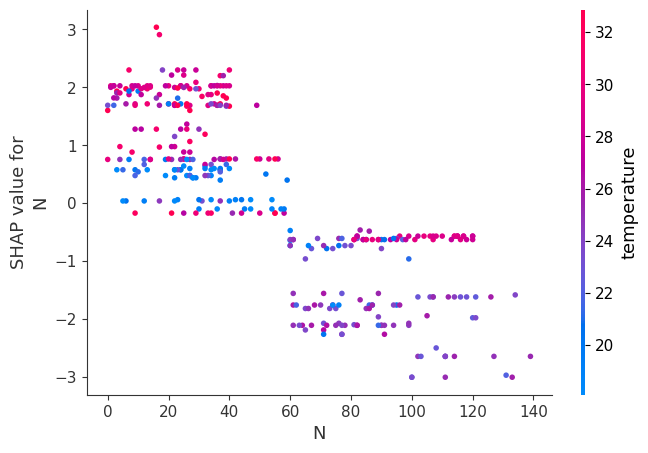

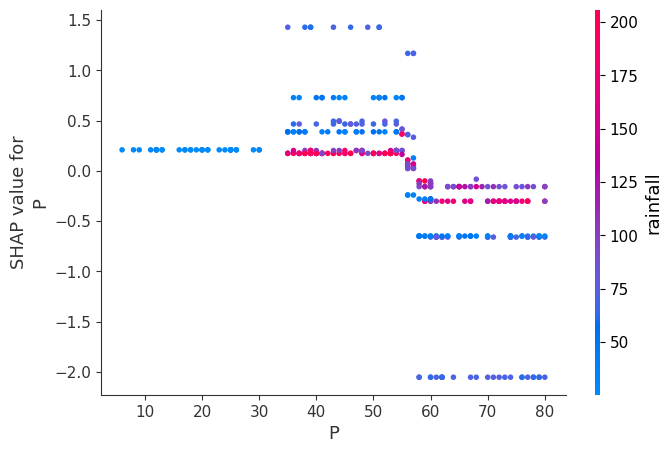

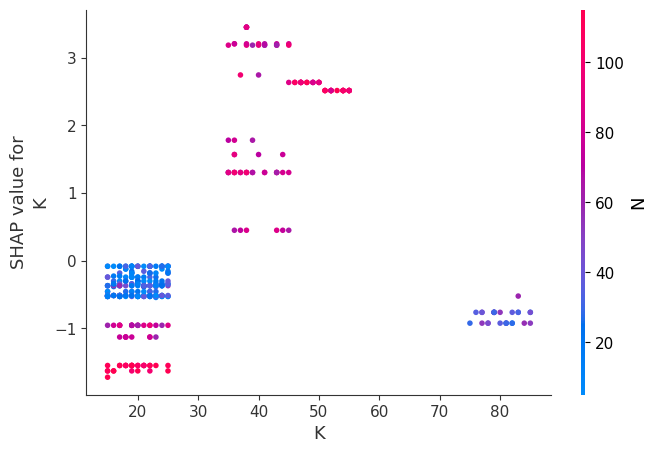

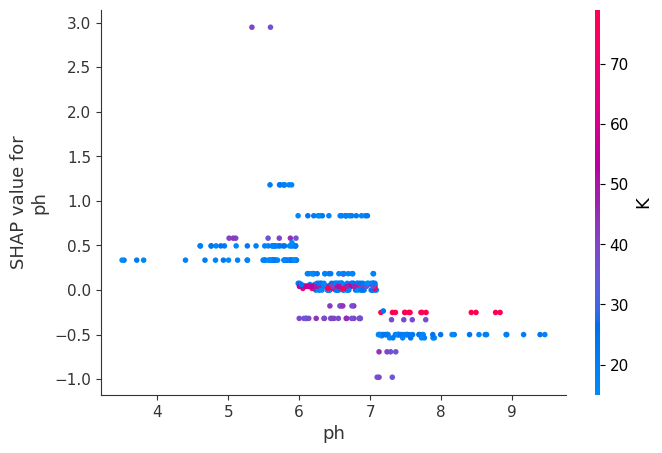

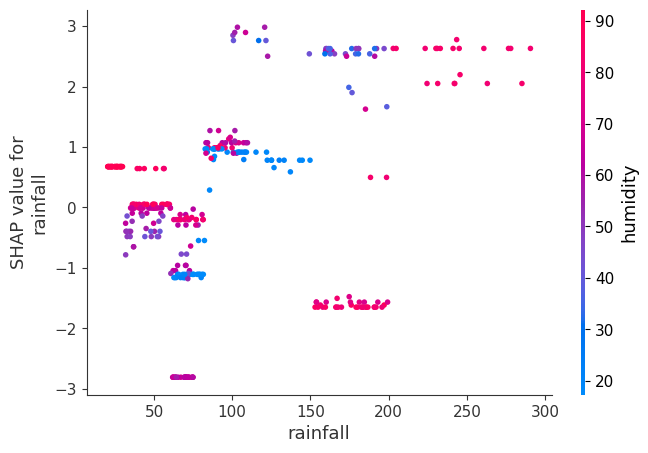

In [ ]:
import shap

print("For Decision Tree on AC")
model_rf = models['DT']
model_rf.fit(X_train_ac, y_train_ac)

shap_explainer = shap.Explainer(model_rf.predict, X_train_ac)

shap_values = shap_explainer(X_test_ac)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])

shap.summary_plot(shap_values, X_test_ac)

shap.dependence_plot("temperature", shap_values_array, X_test_ac)
shap.dependence_plot("humidity", shap_values_array, X_test_ac)
shap.dependence_plot("N", shap_values_array, X_test_ac)
shap.dependence_plot("P", shap_values_array, X_test_ac)
shap.dependence_plot("K", shap_values_array, X_test_ac)
shap.dependence_plot("ph", shap_values_array, X_test_ac)
shap.dependence_plot("rainfall", shap_values_array, X_test_ac)

For SVM on AC


ExactExplainer explainer: 361it [00:25,  8.41it/s]


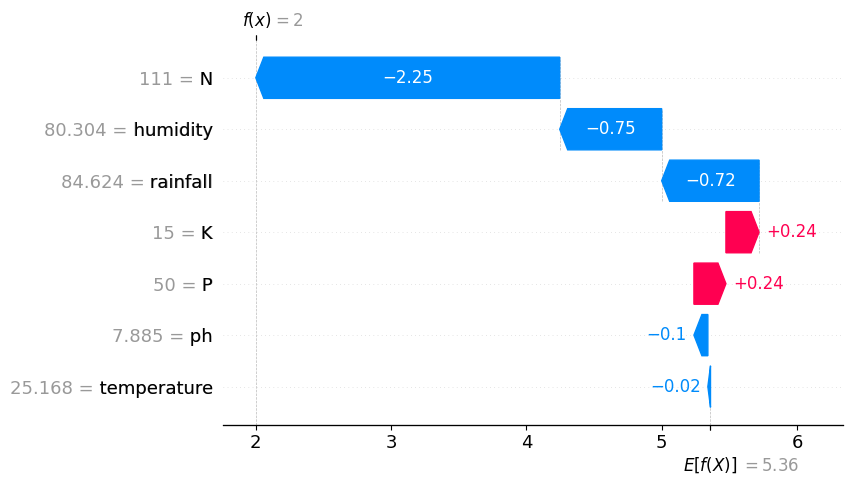

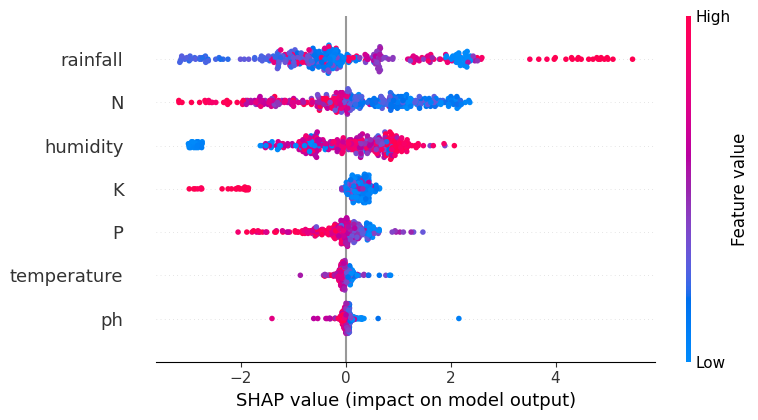

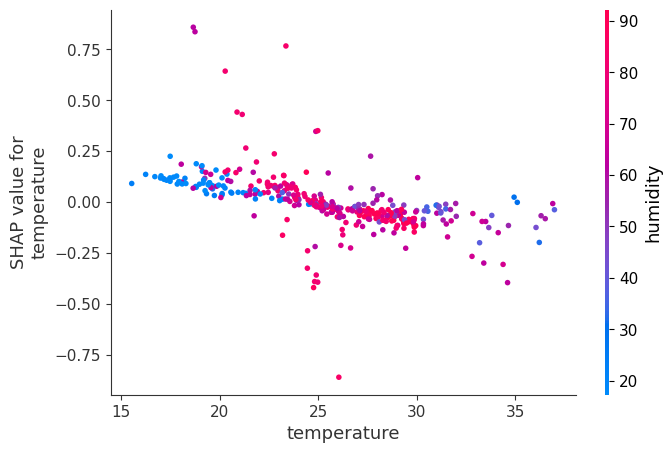

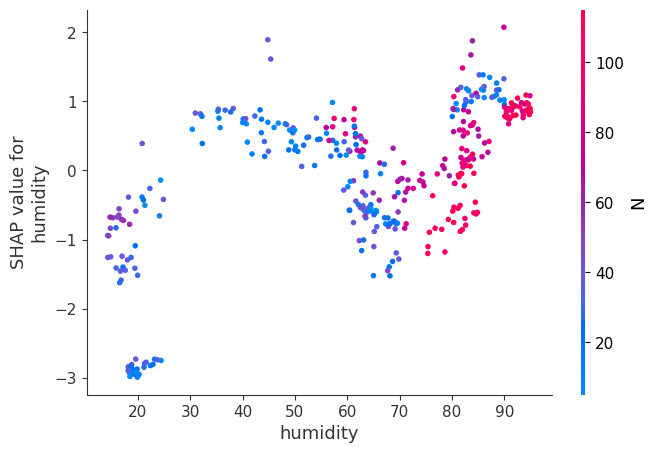

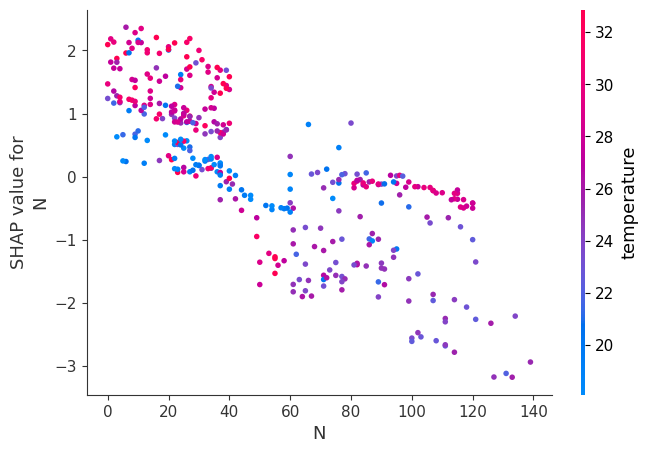

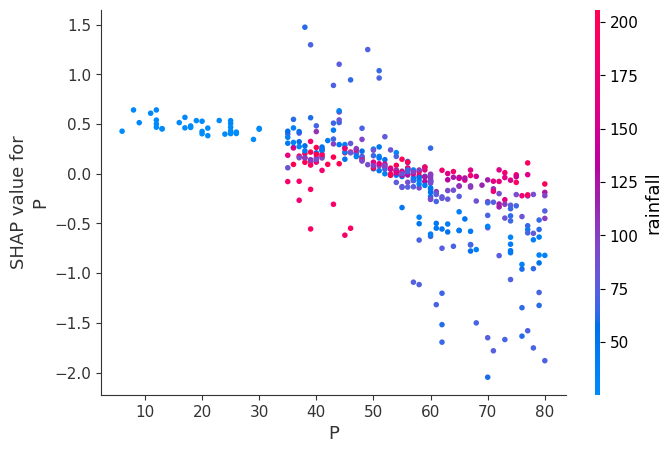

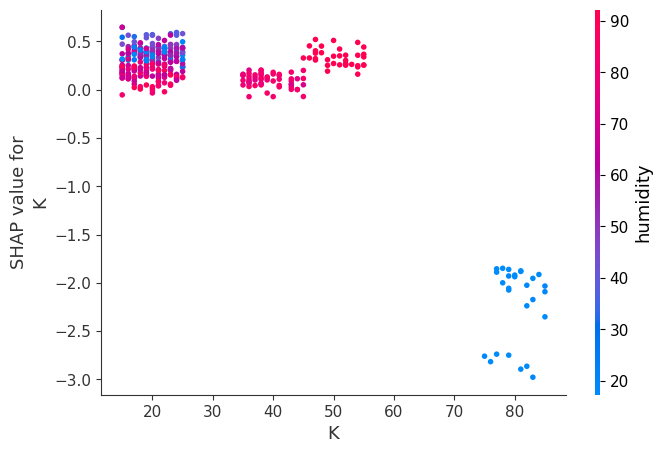

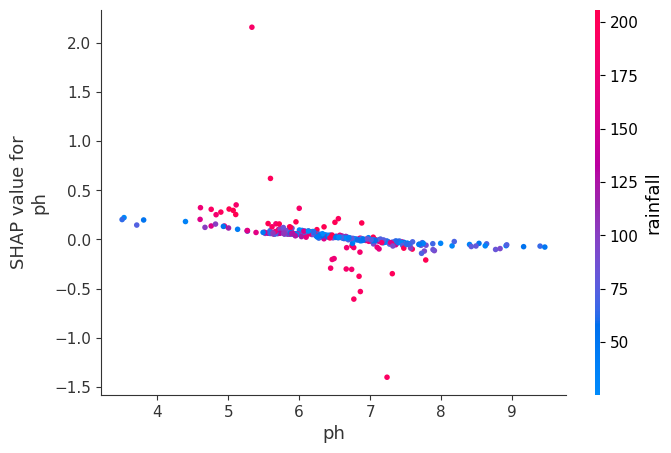

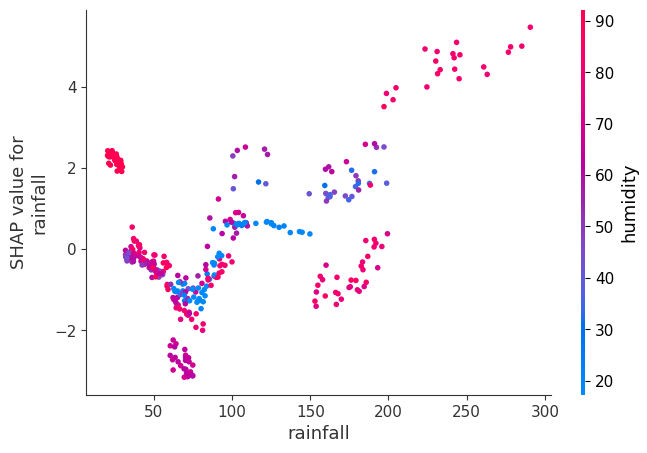

In [ ]:
import shap

print("For SVM on AC")
model_rf = models['SVM']
model_rf.fit(X_train_ac, y_train_ac)

shap_explainer = shap.Explainer(model_rf.predict, X_train_ac)

shap_values = shap_explainer(X_test_ac)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])

shap.summary_plot(shap_values, X_test_ac)

shap.dependence_plot("temperature", shap_values_array, X_test_ac)
shap.dependence_plot("humidity", shap_values_array, X_test_ac)
shap.dependence_plot("N", shap_values_array, X_test_ac)
shap.dependence_plot("P", shap_values_array, X_test_ac)
shap.dependence_plot("K", shap_values_array, X_test_ac)
shap.dependence_plot("ph", shap_values_array, X_test_ac)
shap.dependence_plot("rainfall", shap_values_array, X_test_ac)

For XGBoost on AC


ExactExplainer explainer: 361it [00:51,  5.51it/s]


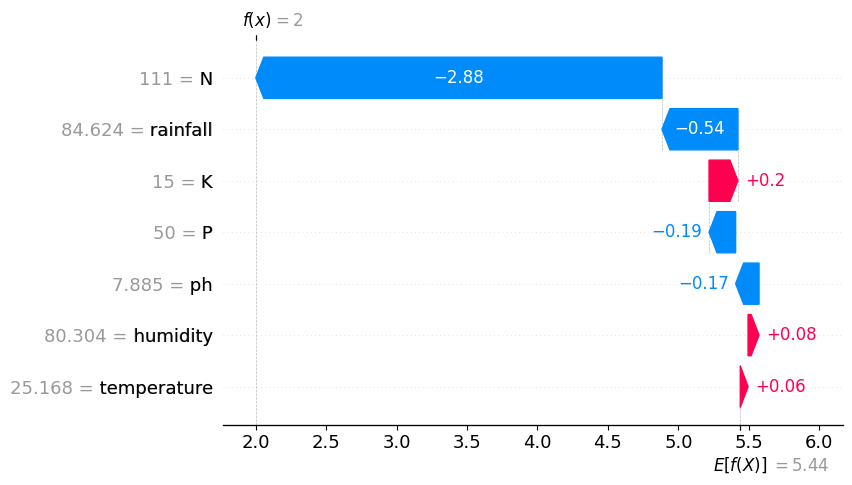

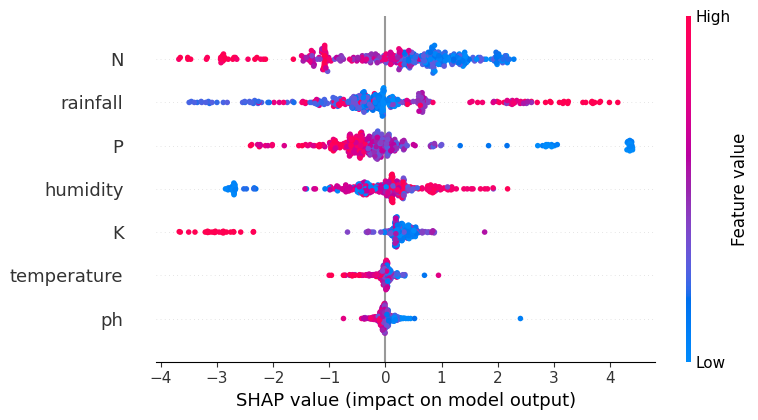

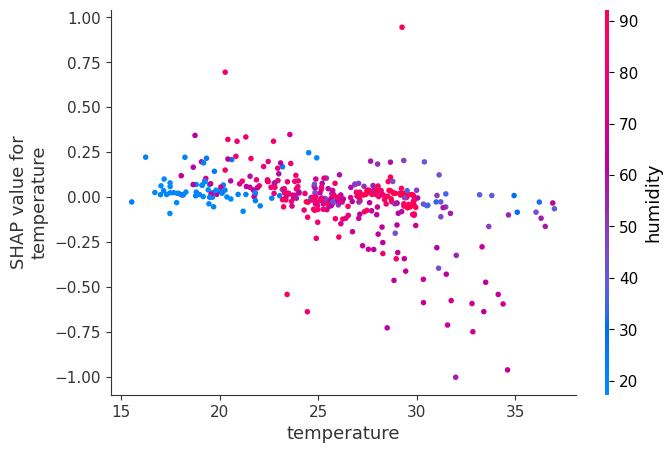

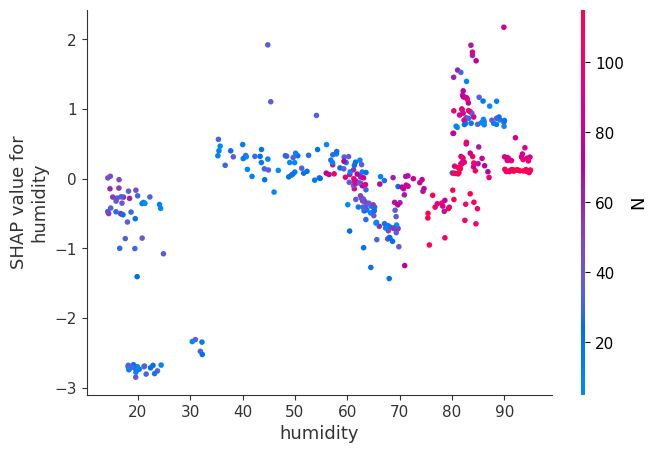

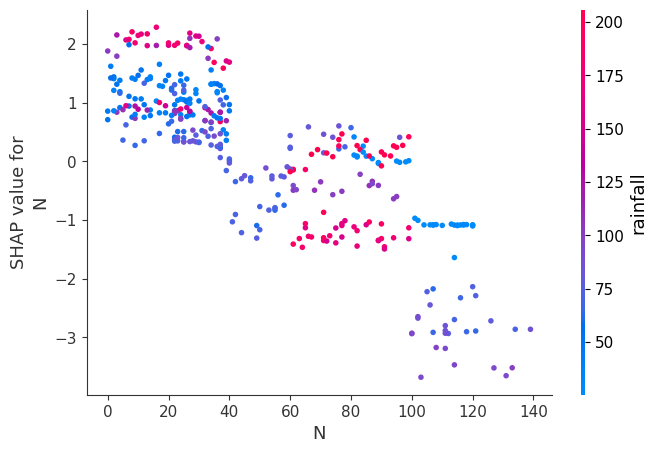

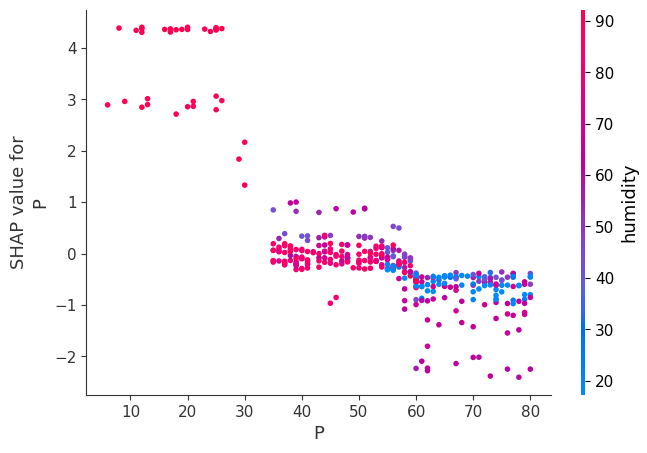

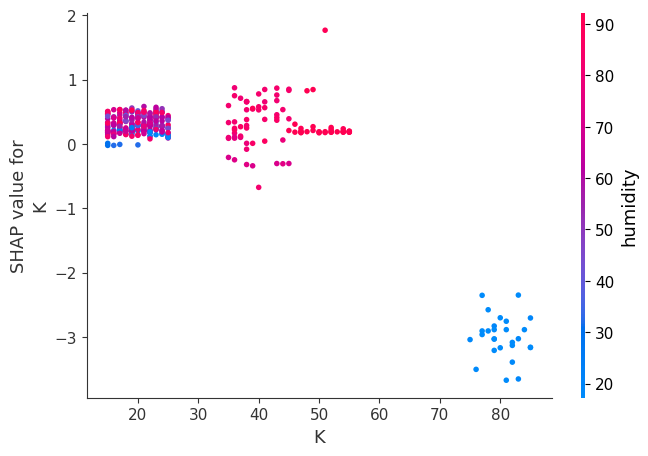

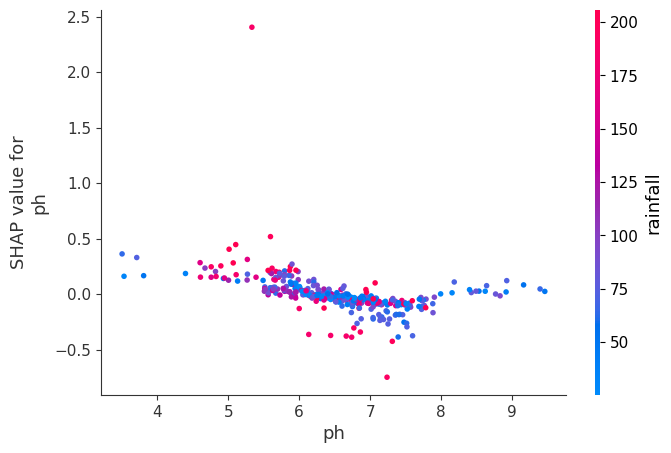

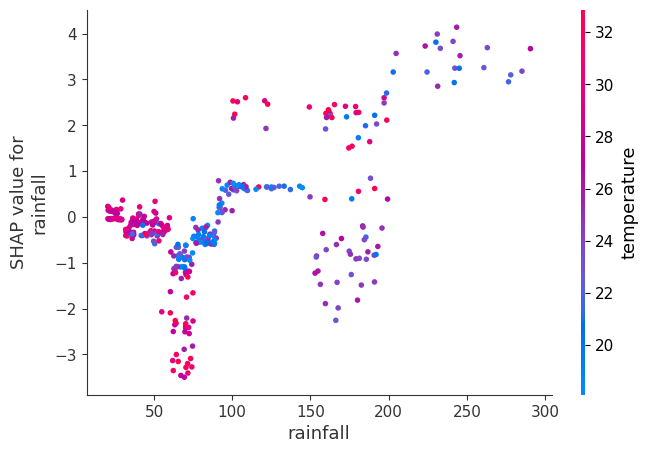

In [ ]:
import shap

print("For XGBoost on AC")
model_rf = models['XGBoost']
model_rf.fit(X_train_ac, y_train_ac)

shap_explainer = shap.Explainer(model_rf.predict, X_train_ac)

shap_values = shap_explainer(X_test_ac)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])

shap.summary_plot(shap_values, X_test_ac)

shap.dependence_plot("temperature", shap_values_array, X_test_ac)
shap.dependence_plot("humidity", shap_values_array, X_test_ac)
shap.dependence_plot("N", shap_values_array, X_test_ac)
shap.dependence_plot("P", shap_values_array, X_test_ac)
shap.dependence_plot("K", shap_values_array, X_test_ac)
shap.dependence_plot("ph", shap_values_array, X_test_ac)
shap.dependence_plot("rainfall", shap_values_array, X_test_ac)

For KNN on AC


ExactExplainer explainer: 361it [04:29,  1.29it/s]


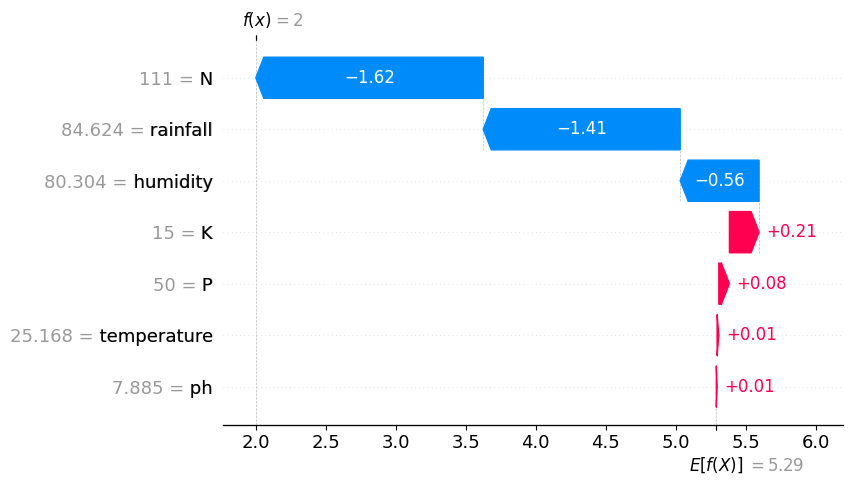

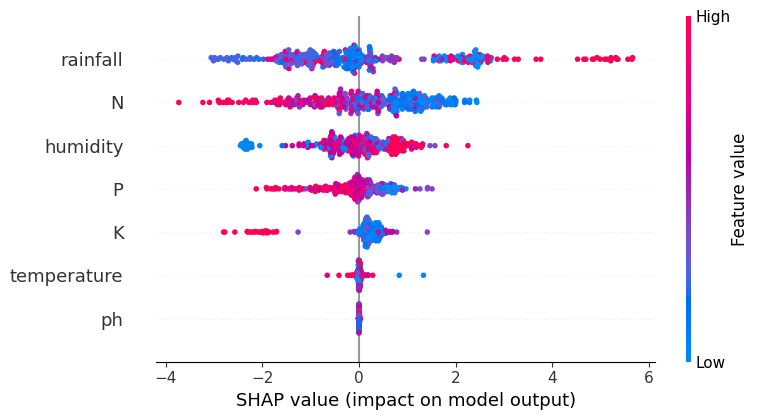

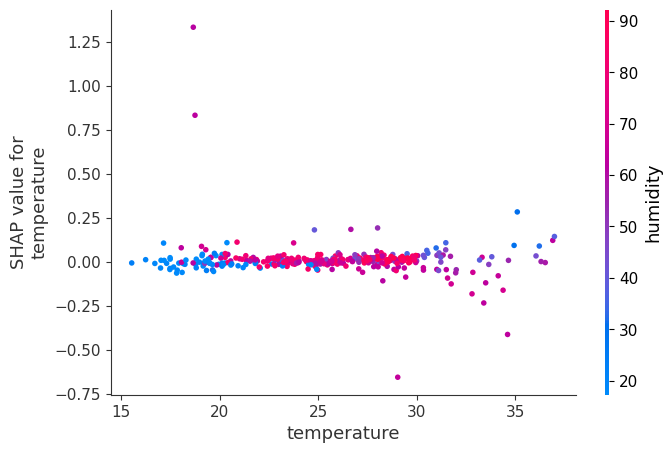

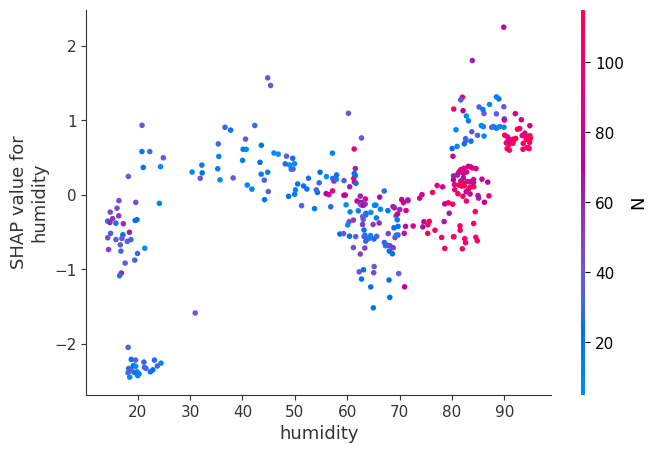

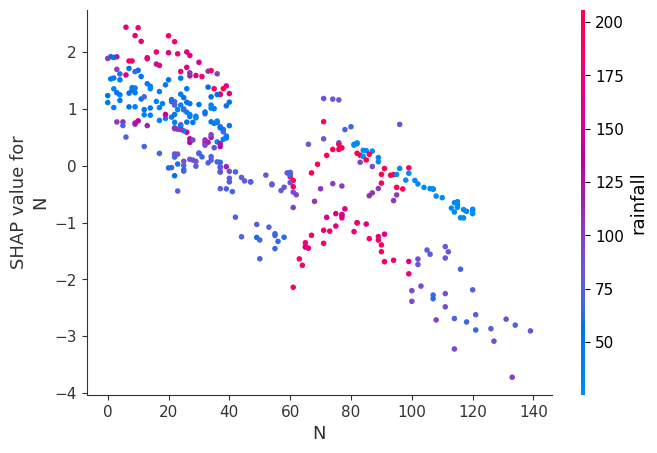

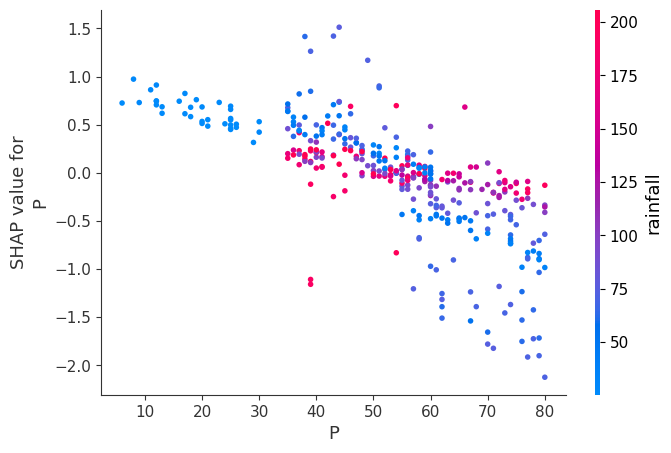

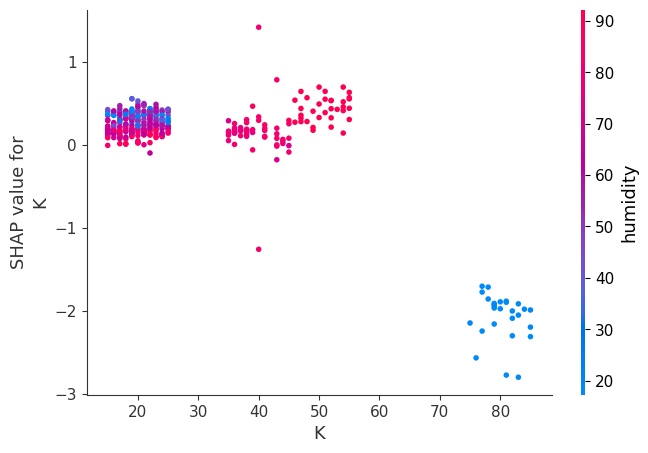

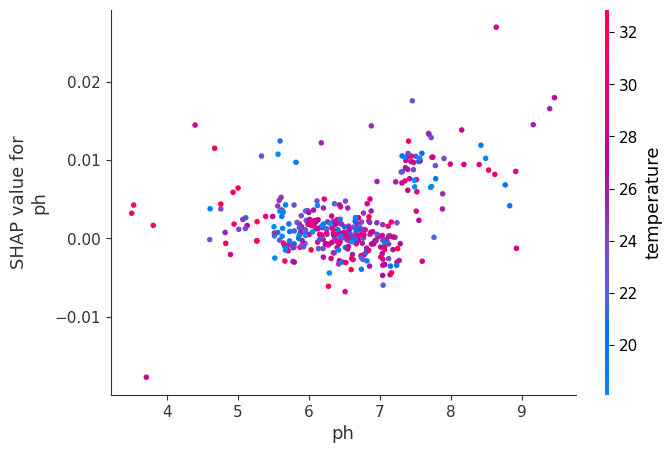

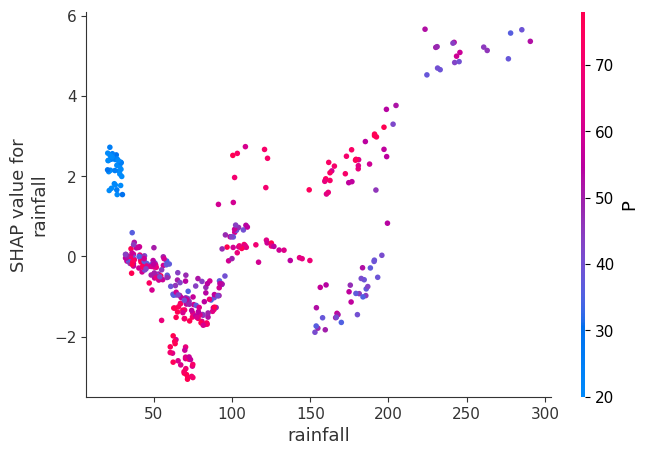

In [ ]:
import shap

print("For KNN on AC")
model_rf = models['KNN']
model_rf.fit(X_train_ac, y_train_ac)

shap_explainer = shap.Explainer(model_rf.predict, X_train_ac)

shap_values = shap_explainer(X_test_ac)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])
shap.summary_plot(shap_values, X_test_ac)

shap.dependence_plot("temperature", shap_values_array, X_test_ac)
shap.dependence_plot("humidity", shap_values_array, X_test_ac)
shap.dependence_plot("N", shap_values_array, X_test_ac)
shap.dependence_plot("P", shap_values_array, X_test_ac)
shap.dependence_plot("K", shap_values_array, X_test_ac)
shap.dependence_plot("ph", shap_values_array, X_test_ac)
shap.dependence_plot("rainfall", shap_values_array, X_test_ac)

For RF on HC


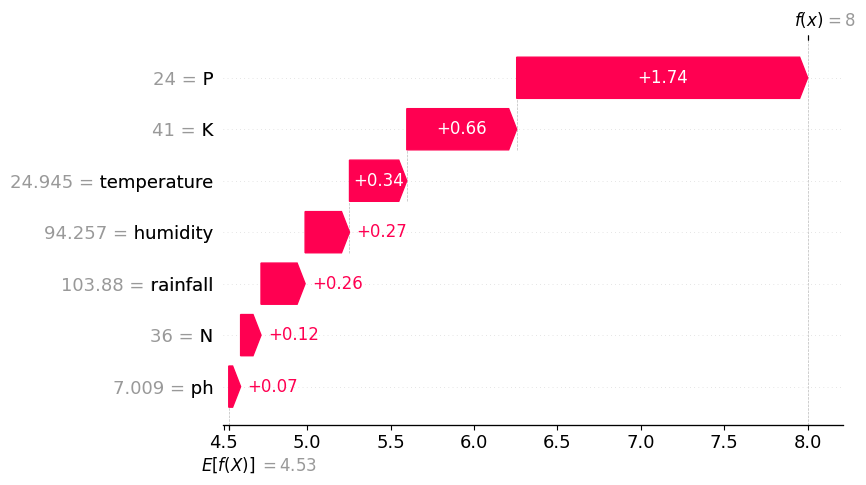

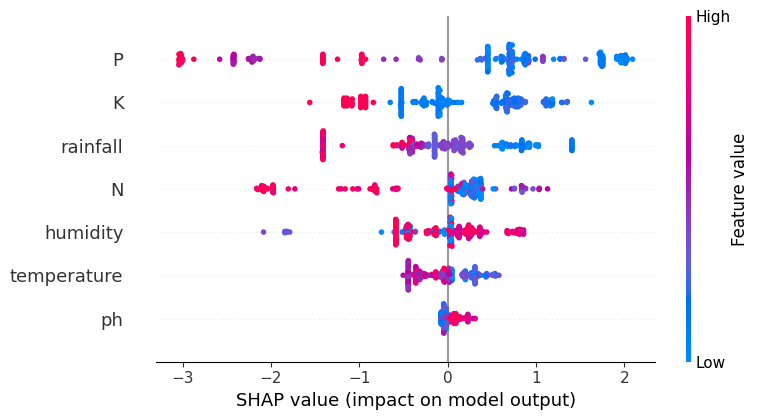

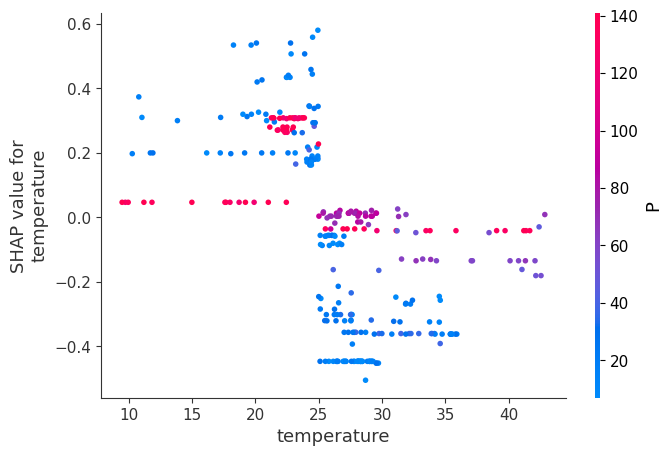

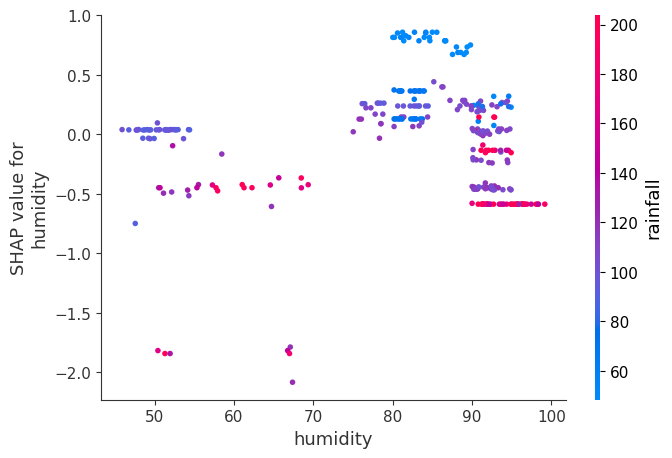

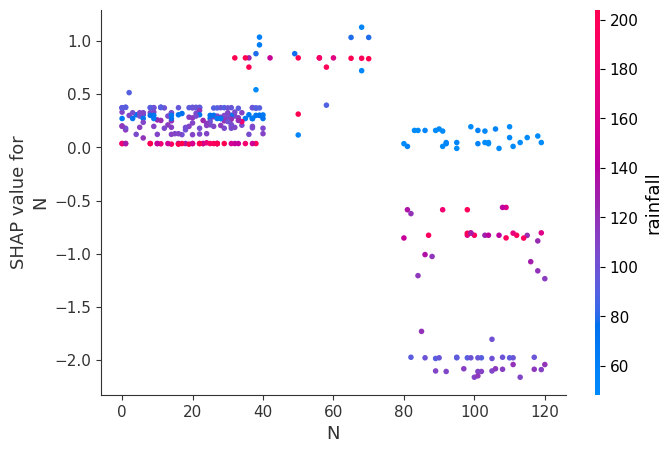

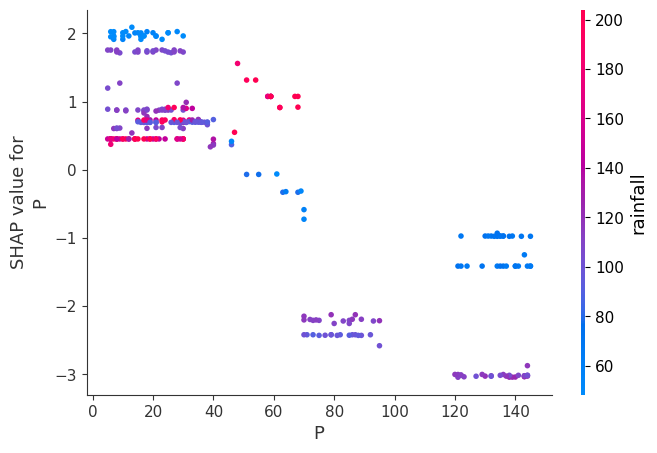

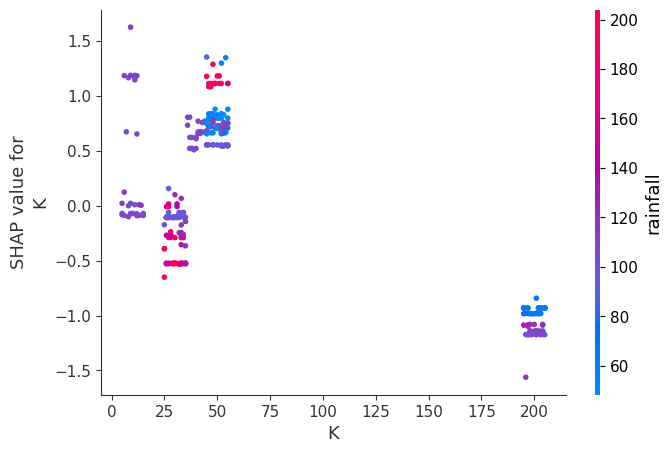

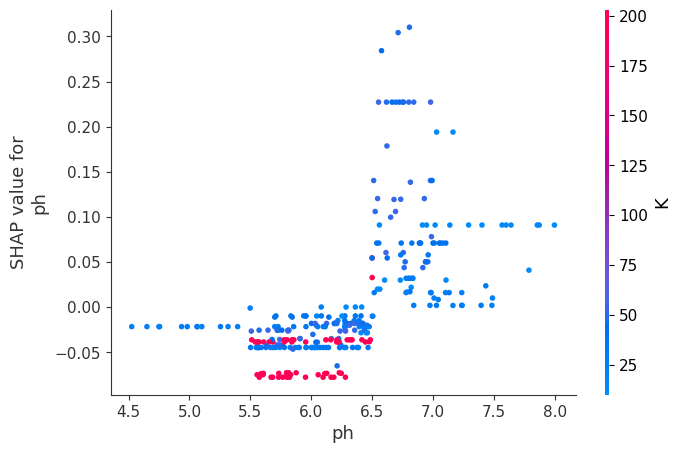

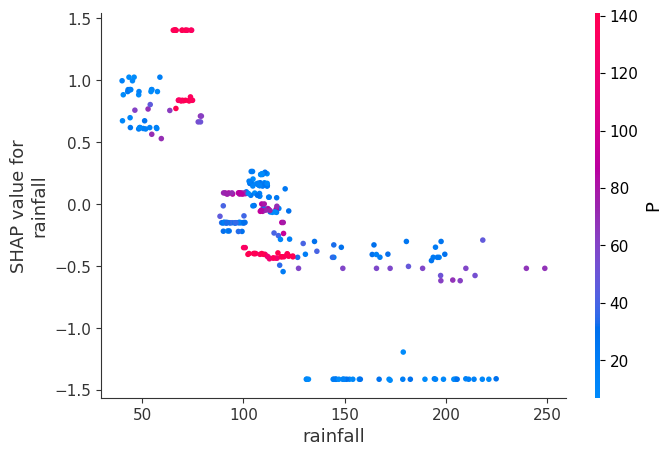

In [ ]:
import shap
print("For RF on HC")
model_rf = models['RF']
model_rf.fit(X_train_hc, y_train_hc)

shap_explainer = shap.Explainer(model_rf.predict, X_train_hc)

shap_values = shap_explainer(X_test_hc)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])

shap.summary_plot(shap_values, X_test_hc)

shap.dependence_plot("temperature", shap_values_array, X_test_hc)
shap.dependence_plot("humidity", shap_values_array, X_test_hc)
shap.dependence_plot("N", shap_values_array, X_test_hc)
shap.dependence_plot("P", shap_values_array, X_test_hc)
shap.dependence_plot("K", shap_values_array, X_test_hc)
shap.dependence_plot("ph", shap_values_array, X_test_hc)
shap.dependence_plot("rainfall", shap_values_array, X_test_hc)

For DT on HC


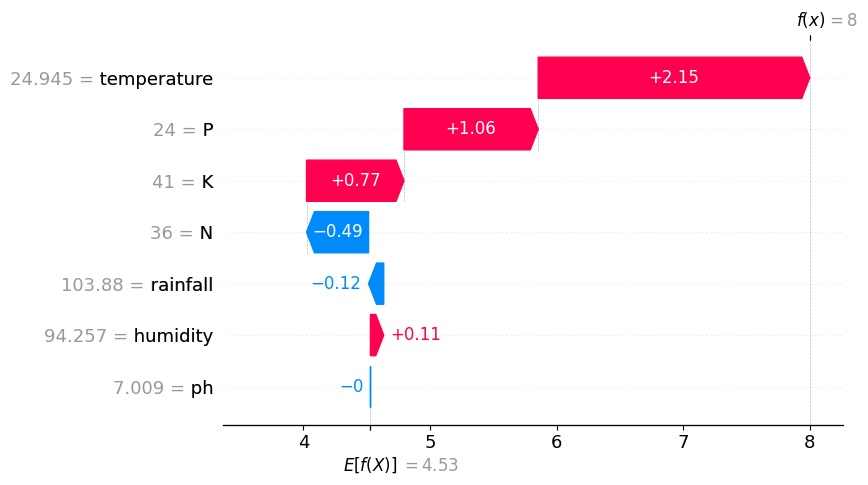

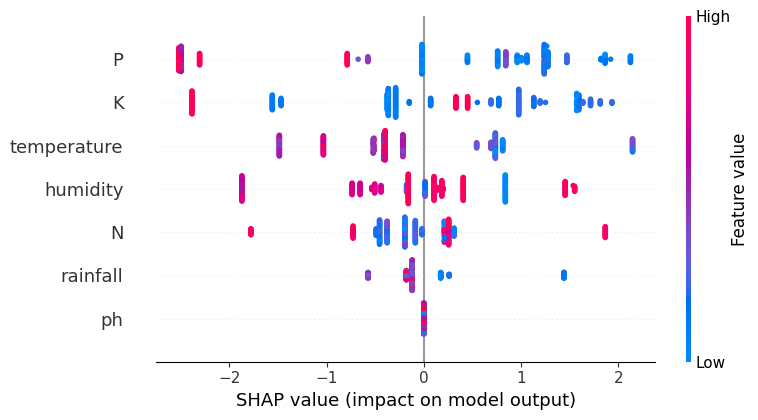

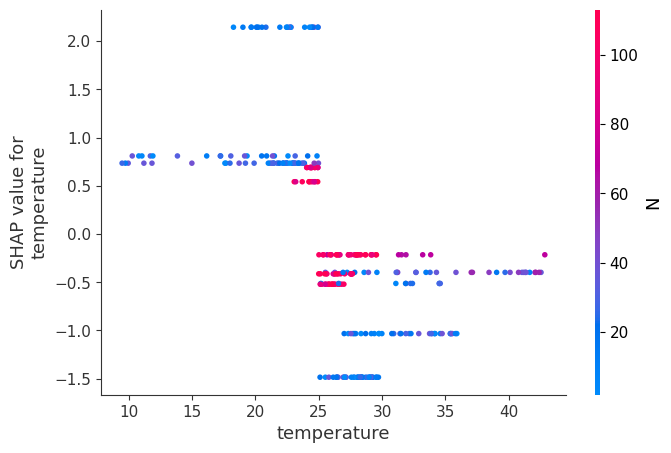

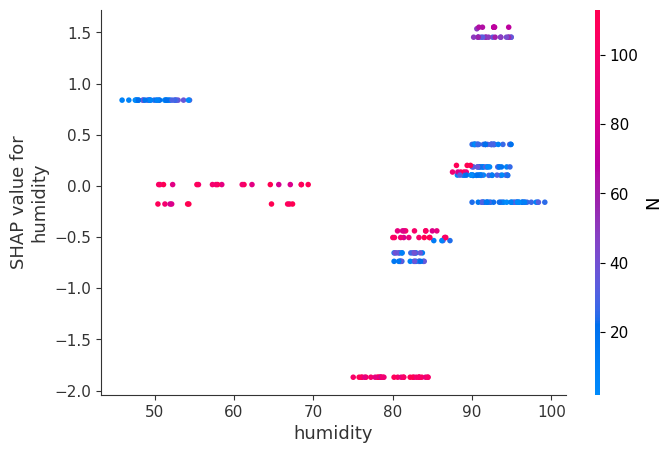

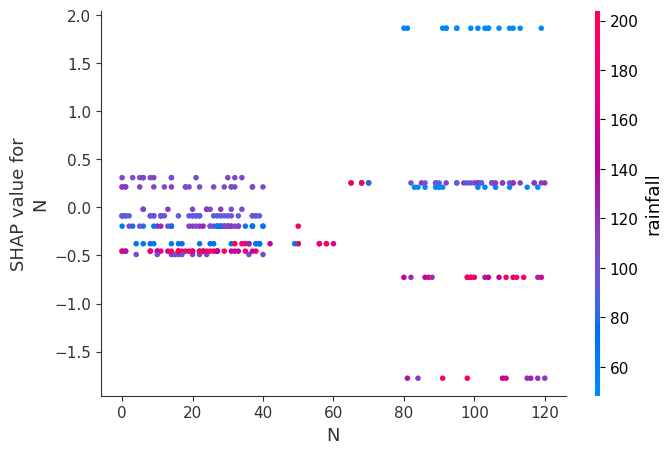

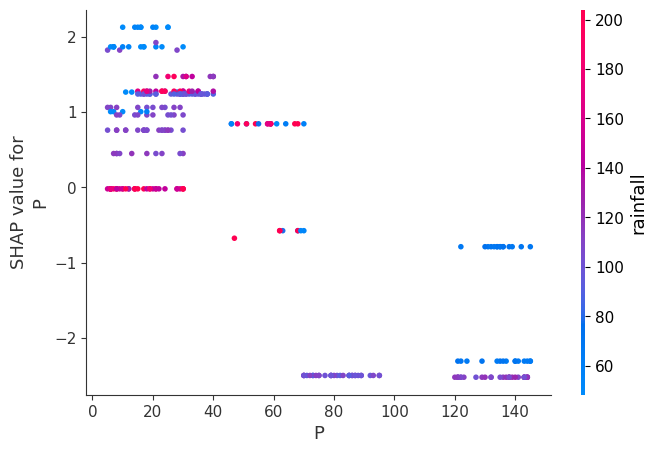

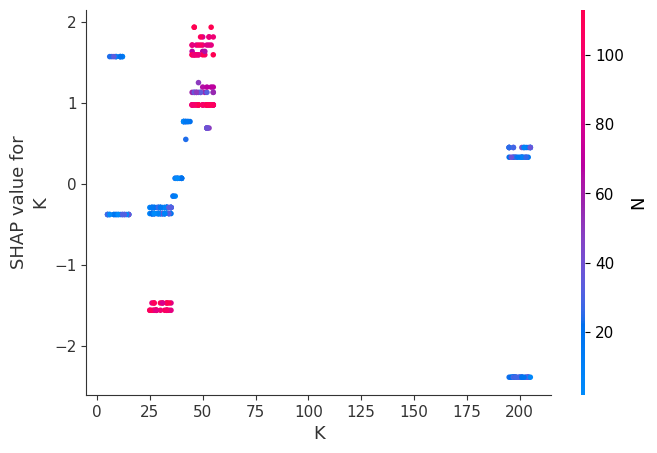

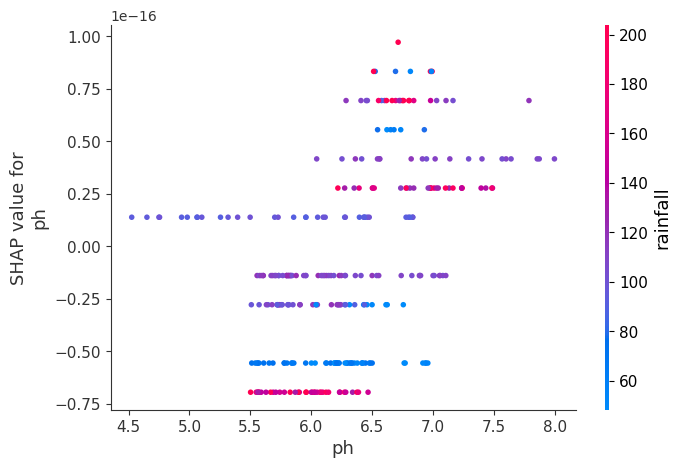

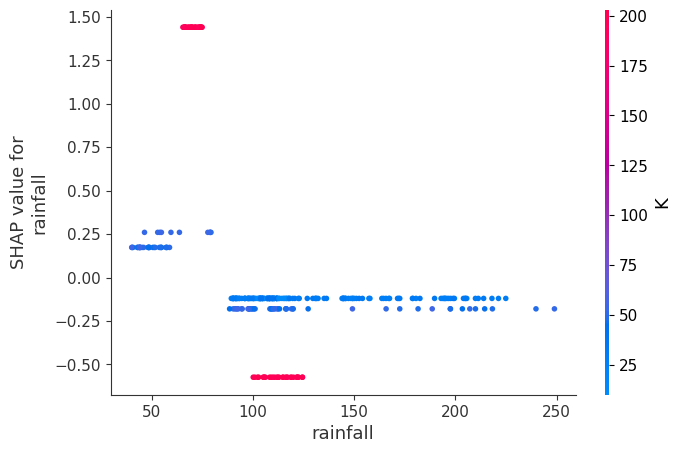

In [ ]:
import shap
print("For DT on HC")
model_rf = models['DT']
model_rf.fit(X_train_hc, y_train_hc)

shap_explainer = shap.Explainer(model_rf.predict, X_train_hc)

shap_values = shap_explainer(X_test_hc)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])

shap.summary_plot(shap_values, X_test_hc)

shap.dependence_plot("temperature", shap_values_array, X_test_hc)
shap.dependence_plot("humidity", shap_values_array, X_test_hc)
shap.dependence_plot("N", shap_values_array, X_test_hc)
shap.dependence_plot("P", shap_values_array, X_test_hc)
shap.dependence_plot("K", shap_values_array, X_test_hc)
shap.dependence_plot("ph", shap_values_array, X_test_hc)
shap.dependence_plot("rainfall", shap_values_array, X_test_hc)

For XGBoost on HC


ExactExplainer explainer: 301it [00:28,  6.99it/s]                         


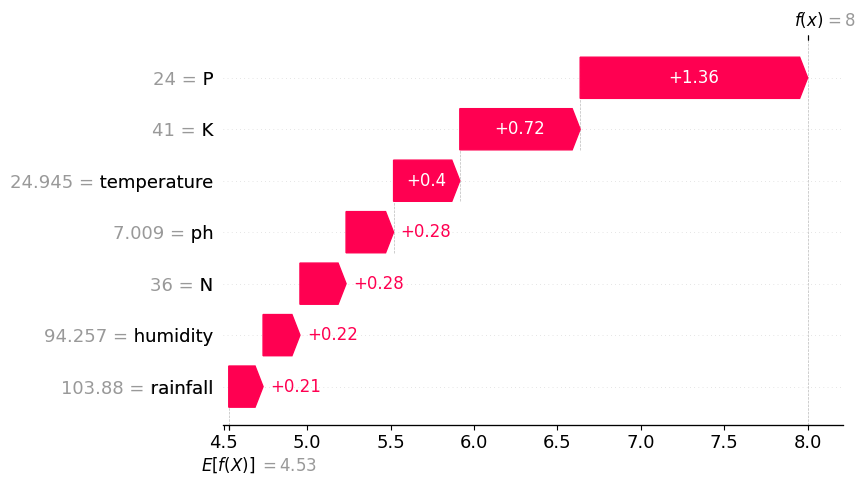

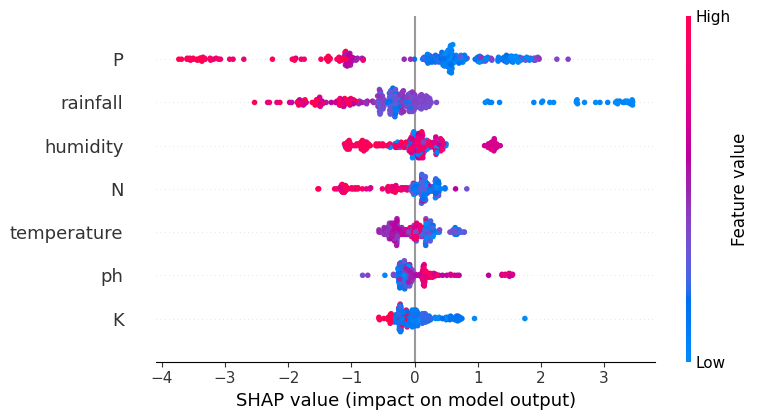

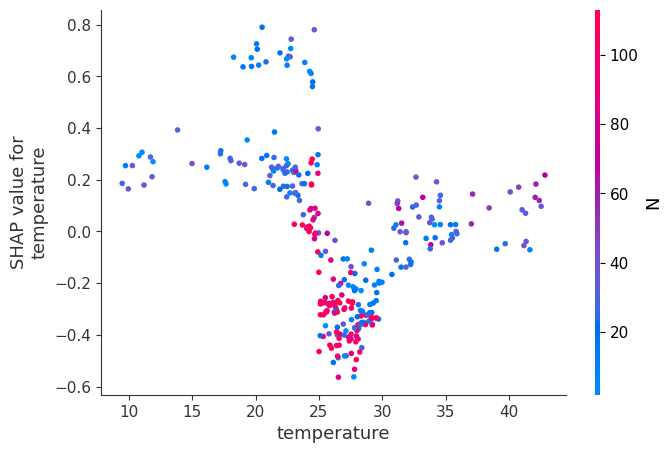

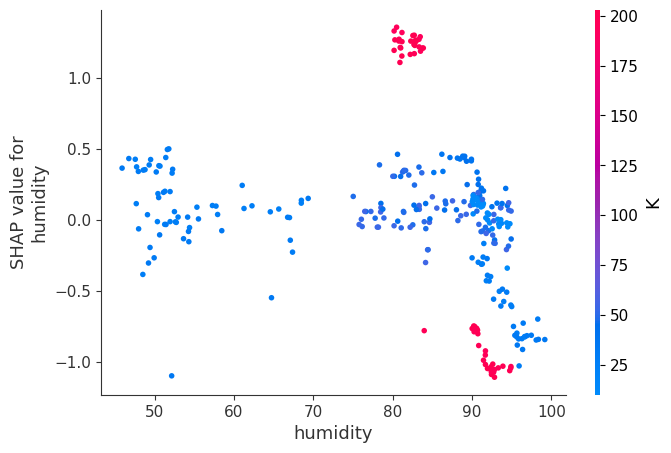

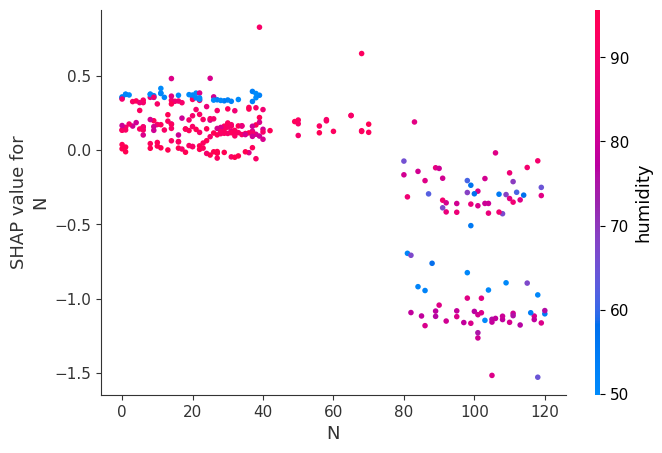

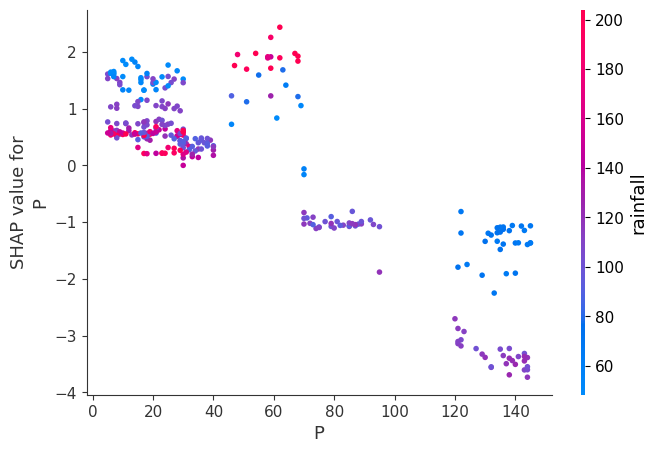

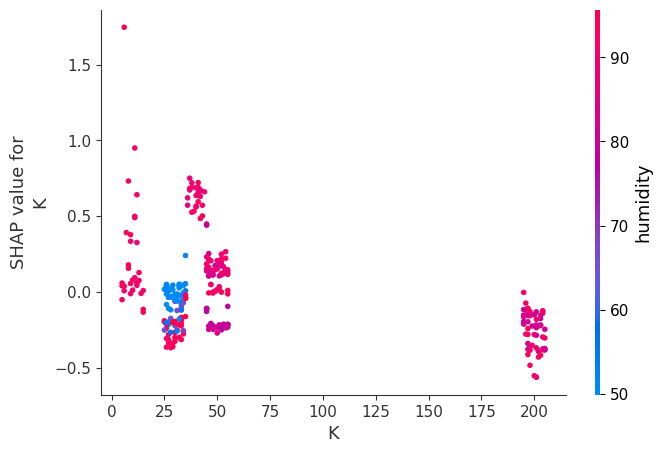

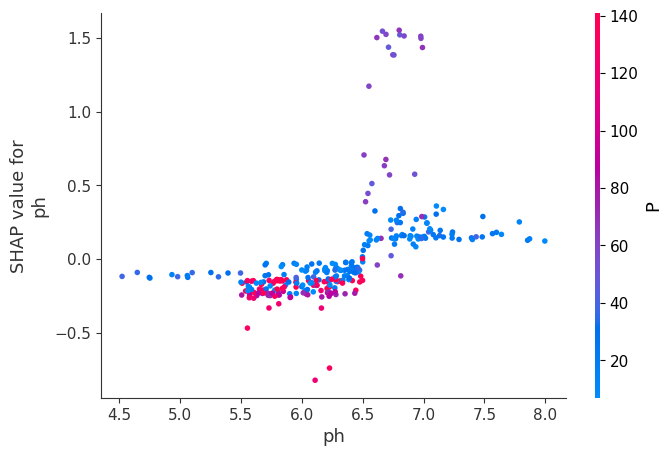

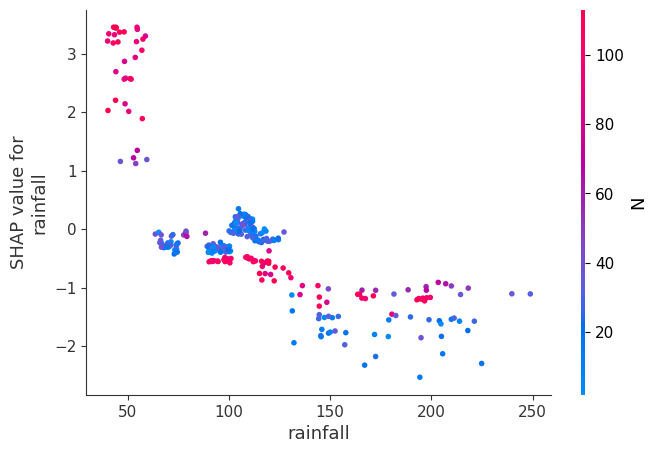

In [ ]:
import shap
print("For XGBoost on HC")
model_rf = models['XGBoost']
model_rf.fit(X_train_hc, y_train_hc)

shap_explainer = shap.Explainer(model_rf.predict, X_train_hc)

shap_values = shap_explainer(X_test_hc)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])

shap.summary_plot(shap_values, X_test_hc)

shap.dependence_plot("temperature", shap_values_array, X_test_hc)
shap.dependence_plot("humidity", shap_values_array, X_test_hc)
shap.dependence_plot("N", shap_values_array, X_test_hc)
shap.dependence_plot("P", shap_values_array, X_test_hc)
shap.dependence_plot("K", shap_values_array, X_test_hc)
shap.dependence_plot("ph", shap_values_array, X_test_hc)
shap.dependence_plot("rainfall", shap_values_array, X_test_hc)

For KNN on HC


ExactExplainer explainer: 301it [04:14,  1.13it/s]


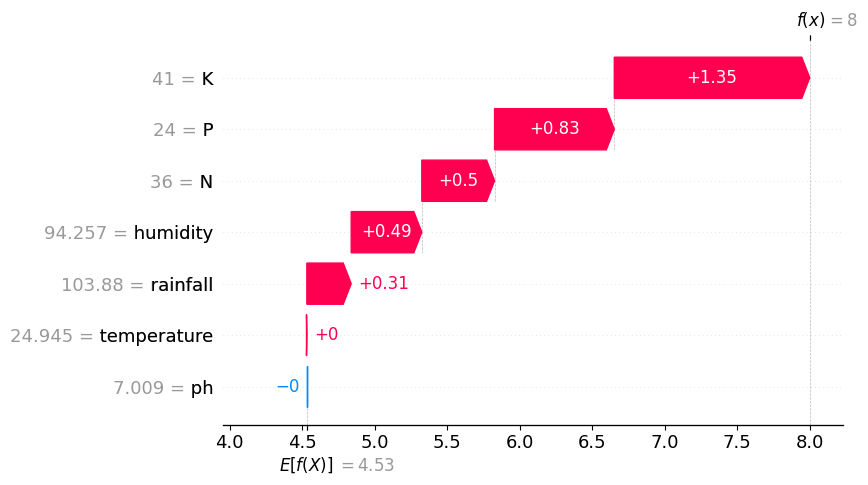

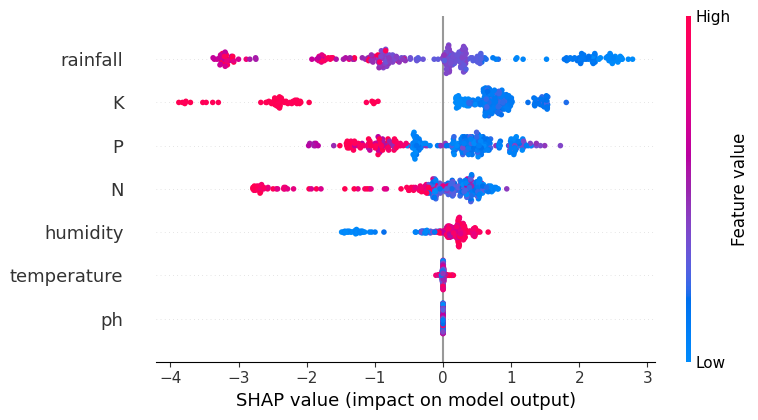

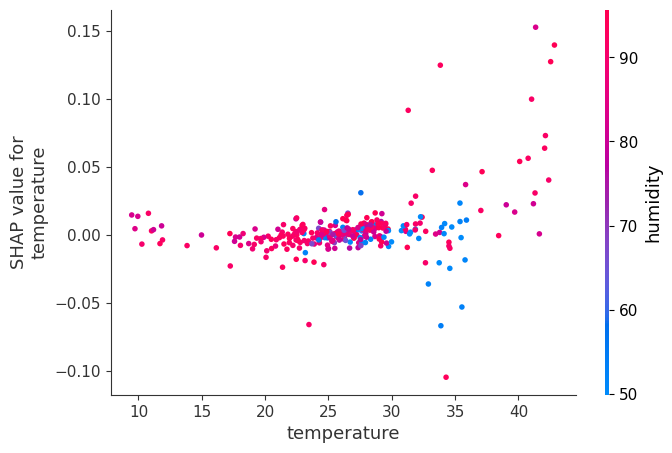

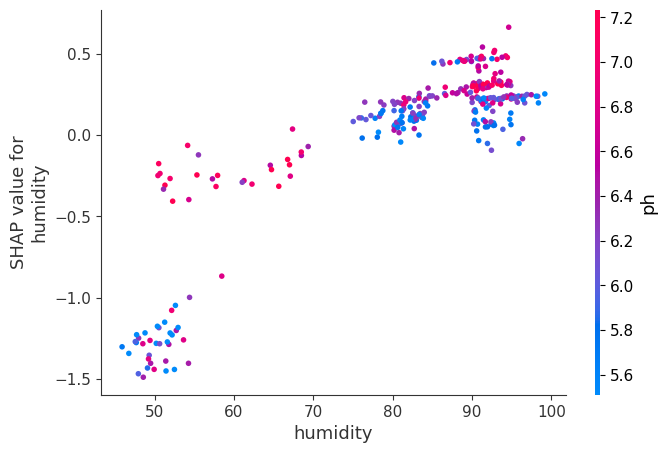

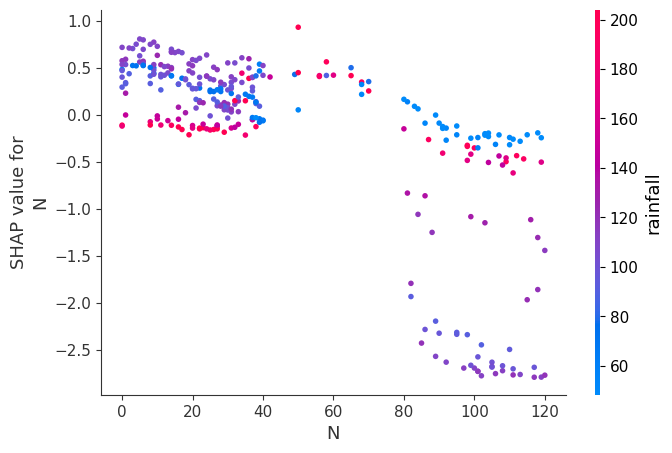

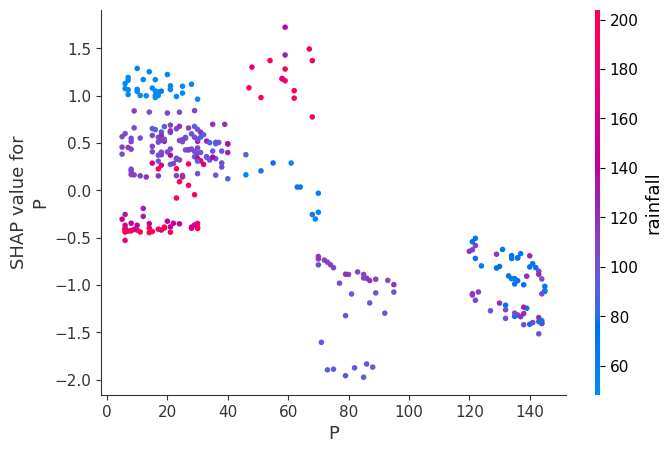

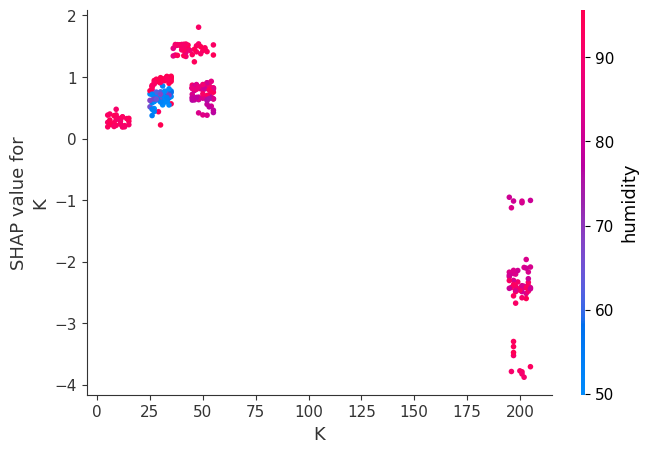

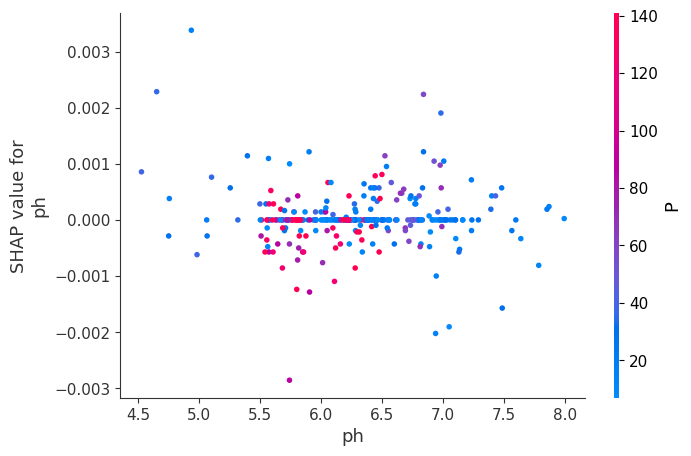

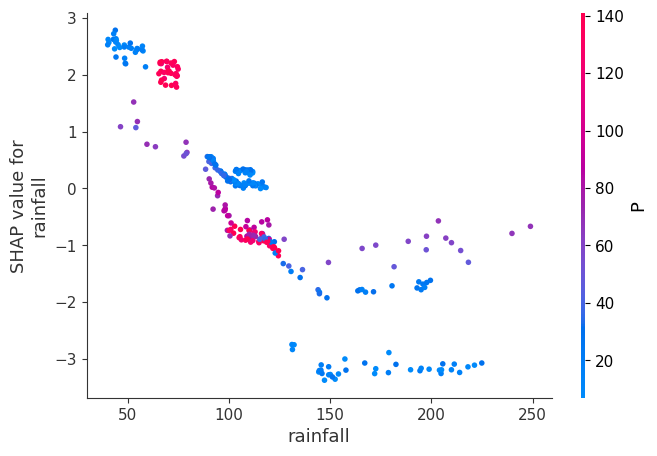

In [ ]:
import shap
print("For KNN on HC")
model_rf = models['KNN']
model_rf.fit(X_train_hc, y_train_hc)

shap_explainer = shap.Explainer(model_rf.predict, X_train_hc)

shap_values = shap_explainer(X_test_hc)

shap_values_array = shap_values.values

shap.plots.waterfall(shap_values[0])

shap.summary_plot(shap_values, X_test_hc)

shap.dependence_plot("temperature", shap_values_array, X_test_hc)
shap.dependence_plot("humidity", shap_values_array, X_test_hc)
shap.dependence_plot("N", shap_values_array, X_test_hc)
shap.dependence_plot("P", shap_values_array, X_test_hc)
shap.dependence_plot("K", shap_values_array, X_test_hc)
shap.dependence_plot("ph", shap_values_array, X_test_hc)
shap.dependence_plot("rainfall", shap_values_array, X_test_hc)

In [ ]:
!pip install xgboost tensorflow innvestigate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 840.9/840.9 kB 29.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 489.9/489.9 MB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 42.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 58.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 74.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 440.7/440.7 kB 27.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 7.2 MB/s eta 0:00:00
  Created wheel for future: filename=future-0.18.3-py3-none-any.whl size=492025 sha256=2f1c688da51ae67ce7b5e34ab98da7b3ff76457b43e66e1d92490a6729a90282
  Stored in directory: /root/.cache/pip/wheels/5e/a9/47/f118e66afd12240e4662752cc22cefae5d97275623aa8ef57d
Successfully built future
  Attempting uninstall: wrapt
    Found exi

In [ ]:
import tensorflow as tf
import innvestigate

In [ ]:
import tensorflow as tf

def create_model(input_shape, num_classes):
  """
  Creates a simple sequential model.

  Args:
    input_shape: Shape of the input data.
    num_classes: Number of output classes.

  Returns:
    A compiled Keras model.
  """
  model = tf.keras.models.Sequential([
      tf.keras.layers.Input(shape=input_shape),
      tf.keras.layers.Dense(128, activation='relu'),
      tf.keras.layers.Dense(64, activation='relu'),
      tf.keras.layers.Dense(num_classes, activation='softmax')
  ])
  return model

input_shape = (X_train_ac.shape[1],)  # Get the input shape from your data
num_classes_ac = len(label_encoder_ac.classes_)
model_ac = create_model(input_shape, num_classes_ac) # Pass 'input_shape' instead of 'input_shape_ac'
model_ac.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model_ac.fit(X_train_ac, y_train_ac, epochs=10, batch_size=32, validation_split=0.2)  # Adjust epochs and batch size as needed
_, accuracy_ac = model_ac.evaluate(X_test_ac, y_test_ac)
print(f"Accuracy on AC dataset: {accuracy_ac * 100:.2f}%")

Epoch 1/10
21/21 [==============================] - 1s 15ms/step - loss: 8.6070 - accuracy: 0.2128 - val_loss: 1.9386 - val_accuracy: 0.4583
Epoch 2/10
21/21 [==============================] - 0s 6ms/step - loss: 0.9530 - accuracy: 0.7054 - val_loss: 0.6713 - val_accuracy: 0.7560
Epoch 3/10
21/21 [==============================] - 0s 5ms/step - loss: 0.4767 - accuracy: 0.8378 - val_loss: 0.3631 - val_accuracy: 0.8929
Epoch 4/10
21/21 [==============================] - 0s 6ms/step - loss: 0.3733 - accuracy: 0.8661 - val_loss: 0.3263 - val_accuracy: 0.8810
Epoch 5/10
21/21 [==============================] - 0s 5ms/step - loss: 0.3059 - accuracy: 0.8899 - val_loss: 0.3561 - val_accuracy: 0.8274
Epoch 6/10
21/21 [==============================] - 0s 5ms/step - loss: 0.2806 - accuracy: 0.8943 - val_loss: 0.2617 - val_accuracy: 0.8869
Epoch 7/10
21/21 [==============================] - 0s 5ms/step - loss: 0.2662 - accuracy: 0.9003 - val_loss: 0.2189 - val_accuracy: 0.9167
Epoch 8/10
21/21 [=

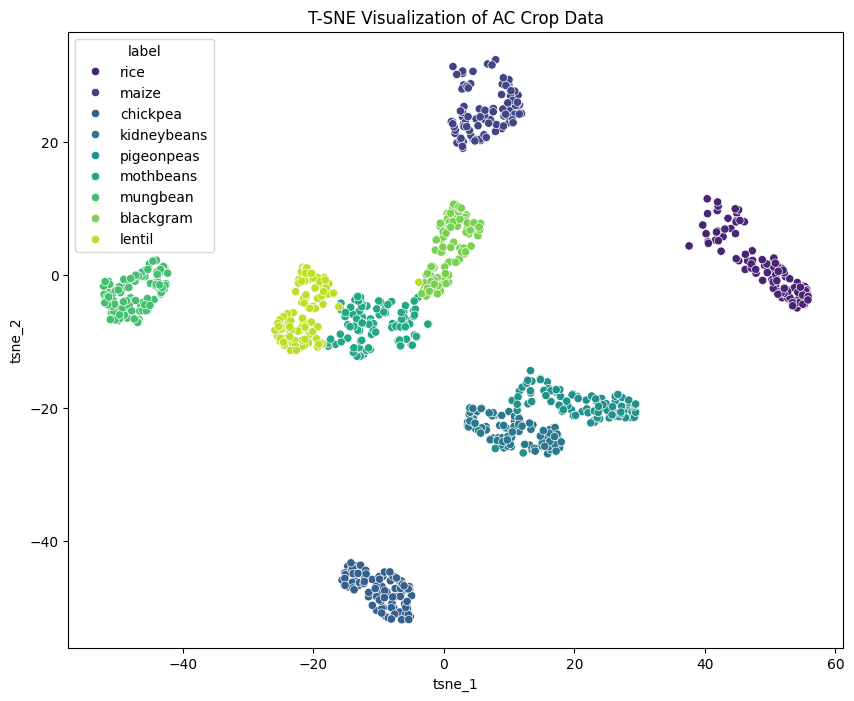

In [ ]:
import pandas as pd
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

# Prepare 'ac' data
X_ac = ac_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']]
y_ac = ac_data['label']

# Apply T-SNE
tsne_ac = TSNE(n_components=2, random_state=42)
X_tsne_ac = tsne_ac.fit_transform(X_ac)

# Visualize
tsne_df_ac = pd.DataFrame(data=X_tsne_ac, columns=['tsne_1', 'tsne_2'])
tsne_df_ac['label'] = y_ac
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_df_ac, palette='viridis')
plt.title('T-SNE Visualization of AC Crop Data')
plt.show()

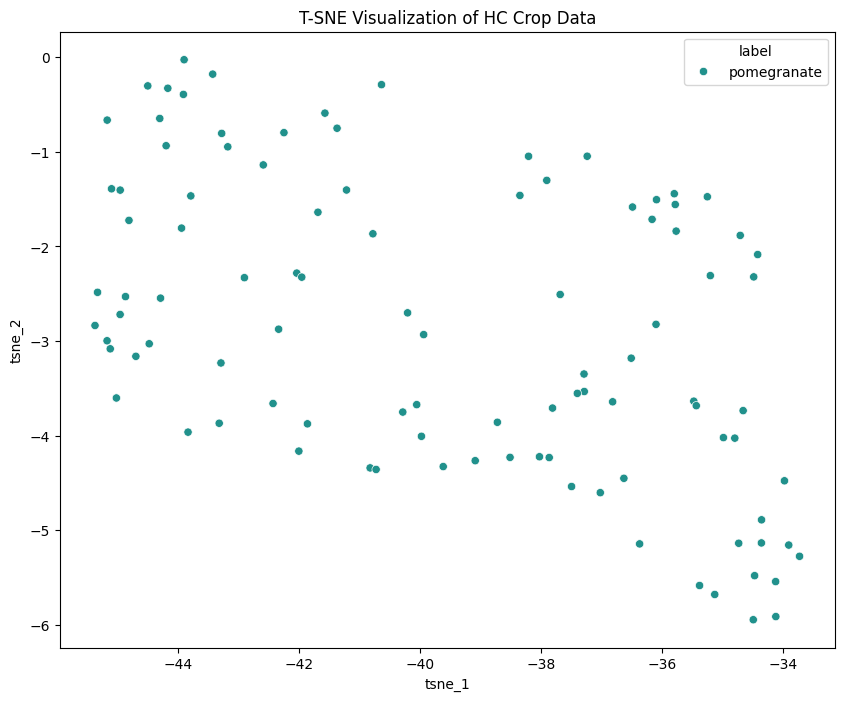

In [ ]:
# Prepare 'hc' data
X_hc = hc_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']]
y_hc = hc_data['label']

# Apply T-SNE
tsne_hc = TSNE(n_components=2, random_state=42)
X_tsne_hc = tsne_hc.fit_transform(X_hc)

# Visualize
tsne_df_hc = pd.DataFrame(data=X_tsne_hc, columns=['tsne_1', 'tsne_2'])
tsne_df_hc['label'] = y_hc
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_df_hc, palette='viridis')
plt.title('T-SNE Visualization of HC Crop Data')
plt.show()

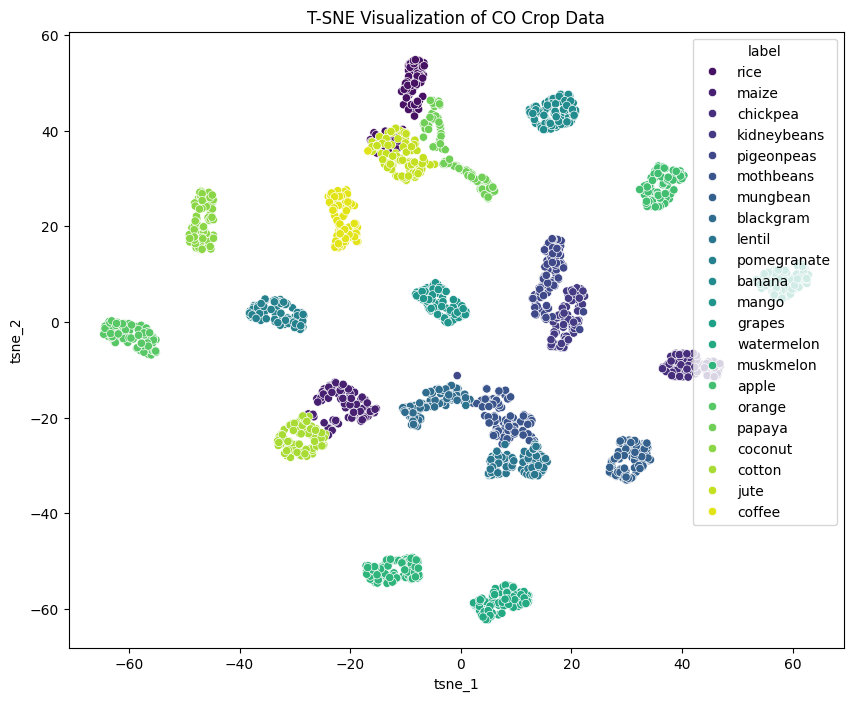

In [ ]:
# Prepare 'co' data
X_co = co_data[['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall']]
y_co = co_data['label']

# Apply T-SNE
tsne_co = TSNE(n_components=2, random_state=42)
X_tsne_co = tsne_co.fit_transform(X_co)

# Visualize
tsne_df_co = pd.DataFrame(data=X_tsne_co, columns=['tsne_1', 'tsne_2'])
tsne_df_co['label'] = y_co
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_df_co, palette='viridis')
plt.title('T-SNE Visualization of CO Crop Data')
plt.show()

In [ ]:
pip install innvestigate

In [ ]:
#lrp alongwith mlp

Train on 1232 samples, validate on 308 samples
Epoch 1/10
1232/1232 [==============================] - 0s 107us/sample - loss: 14.4218 - accuracy: 0.1071 - val_loss: 5.3289 - val_accuracy: 0.1883
Epoch 2/10
1232/1232 [==============================] - 0s 55us/sample - loss: 3.1109 - accuracy: 0.2670 - val_loss: 2.0547 - val_accuracy: 0.3409
Epoch 3/10
1232/1232 [==============================] - 0s 54us/sample - loss: 1.7776 - accuracy: 0.4115 - val_loss: 1.4541 - val_accuracy: 0.4935
Epoch 4/10
  32/1232 [..............................] - ETA: 0s - loss: 1.3001 - accuracy: 0.5312

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates


1232/1232 [==============================] - 0s 57us/sample - loss: 1.2989 - accuracy: 0.5787 - val_loss: 1.0722 - val_accuracy: 0.6981
Epoch 5/10
1232/1232 [==============================] - 0s 72us/sample - loss: 0.9792 - accuracy: 0.6956 - val_loss: 0.8116 - val_accuracy: 0.7435
Epoch 6/10
1232/1232 [==============================] - 0s 59us/sample - loss: 0.7714 - accuracy: 0.7695 - val_loss: 0.6793 - val_accuracy: 0.7825
Epoch 7/10
1232/1232 [==============================] - 0s 88us/sample - loss: 0.6280 - accuracy: 0.8133 - val_loss: 0.5470 - val_accuracy: 0.8247
Epoch 8/10
1232/1232 [==============================] - 0s 81us/sample - loss: 0.5130 - accuracy: 0.8644 - val_loss: 0.4206 - val_accuracy: 0.8604
Epoch 9/10
1232/1232 [==============================] - 0s 81us/sample - loss: 0.3881 - accuracy: 0.8985 - val_loss: 0.3634 - val_accuracy: 0.8896
Epoch 10/10
1232/1232 [==============================] - 0s 105us/sample - loss: 0.3328 - accuracy: 0.9075 - val_loss: 0.3061 - v

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


Relevance scores for input: [[-6.5508575 -7.4212985  3.567283  -3.0148594 24.126177   2.2497082
  85.38884  ]]


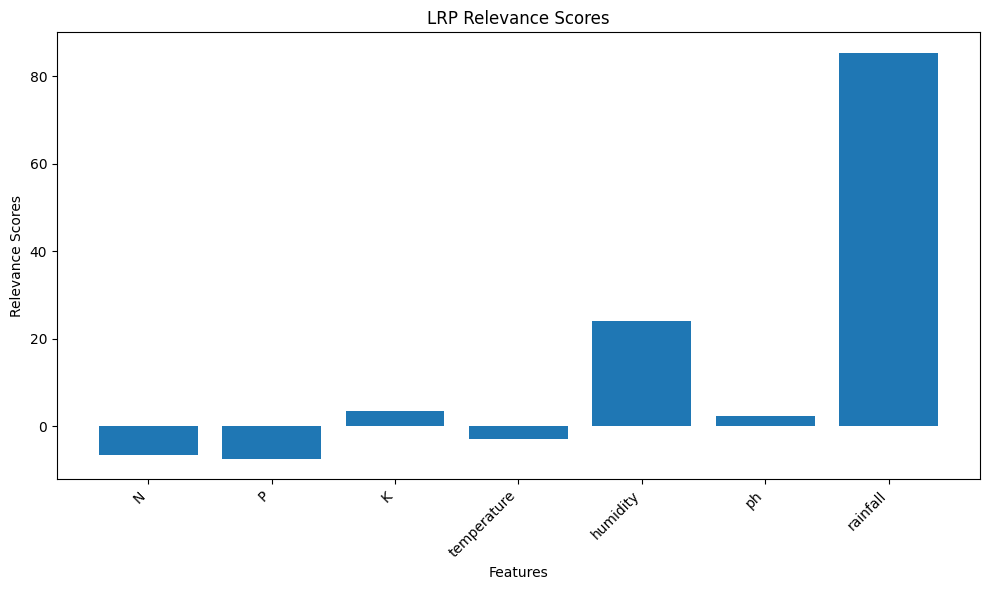

In [ ]:
!pip install xgboost tensorflow innvestigate

import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import innvestigate
import matplotlib.pyplot as plt

# Disable eager execution
tf.compat.v1.disable_eager_execution()

# Define the MLP model
def create_model(input_shape, num_classes):
    model = Sequential()
    model.add(Dense(78, activation='relu', input_shape=input_shape))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(num_classes, activation='softmax'))
    return model

# Assuming X_train_co, y_train_co, X_test_co, y_test_co, and label_encoder_co are already defined

input_shape = (X_train_co.shape[1],)
num_classes = len(label_encoder_co.classes_)

# Create and compile the original model
model = create_model(input_shape, num_classes)
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train_co, y_train_co, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate on the test set
_, accuracy = model.evaluate(X_test_co, y_test_co)
print(f"Accuracy on test data: {accuracy * 100:.2f}%")

# Create a modified version of the model with linear activation in the output layer
model_lrp = create_model(input_shape, num_classes)

# Change the activation of the last layer to linear
model_lrp.layers[-1].activation = tf.keras.activations.linear

# Compile the modified model
model_lrp.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Apply LRP using iNNvestigate
analyzer = innvestigate.create_analyzer("lrp.z", model_lrp)

# Choose an example from the test set to explain
input_example = X_test_co[0:1]

# Compute the LRP relevance score for the example
relevance = analyzer.analyze(input_example)*100

# Print the relevance scores
print("Relevance scores for input:", relevance)

# Visualize the relevance as a bar plot instead of imshow
plt.figure(figsize=(10, 6))
plt.bar(range(relevance.shape[1]), relevance[0])  # Assuming relevance has shape (1, 7)
plt.xticks(range(relevance.shape[1]), X_test_co.columns, rotation=45, ha='right')  # Set x-axis labels
plt.xlabel("Features")
plt.ylabel("Relevance Scores")
plt.title("LRP Relevance Scores")
plt.tight_layout()
plt.show()

In [ ]:
import innvestigate
import innvestigate.utils as iutils

In [ ]:
def create_model(input_shape, num_classes):
    model = Sequential()
    model.add(Dense(64, activation='relu', input_shape=input_shape))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(num_classes, activation='softmax'))  # Use softmax for multi-class classification
    return model

In [ ]:
# AC dataset
input_shape_ac = (X_train_ac.shape[1],)  # Get the input shape from your data
num_classes_ac = len(label_encoder_ac.classes_)
model_ac = create_model(input_shape_ac, num_classes_ac)
model_ac.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model_ac.fit(X_train_ac, y_train_ac, epochs=10, batch_size=32, validation_split=0.2)  # Adjust epochs and batch size as needed
_, accuracy_ac = model_ac.evaluate(X_test_ac, y_test_ac)
print(f"Accuracy on AC dataset: {accuracy_ac * 100:.2f}%")

input_shape_hc = (X_train_hc.shape[1],)  # Get the input shape from your data
num_classes_hc = len(label_encoder_hc.classes_)
model_hc = create_model(input_shape_hc, num_classes_hc)
model_hc.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model_hc.fit(X_train_hc, y_train_hc, epochs=10, batch_size=32, validation_split=0.2)  # Adjust epochs and batch size as needed
_, accuracy_hc = model_hc.evaluate(X_test_hc, y_test_hc)
print(f"Accuracy on HC dataset: {accuracy_hc * 100:.2f}%")


input_shape_co = (X_train_co.shape[1],)  # Get the input shape from your data
num_classes_co = len(label_encoder_co.classes_)
model_co = create_model(input_shape_co, num_classes_co)
model_co.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model_co.fit(X_train_co, y_train_co, epochs=10, batch_size=32, validation_split=0.2)  # Adjust epochs and batch size as needed
_, accuracy_co = model_co.evaluate(X_test_co, y_test_co)
print(f"Accuracy on Co dataset: {accuracy_hc * 100:.2f}%")


Epoch 1/10
21/21 [==============================] - 1s 11ms/step - loss: 10.6848 - accuracy: 0.2098 - val_loss: 5.3372 - val_accuracy: 0.3512
Epoch 2/10
21/21 [==============================] - 0s 4ms/step - loss: 2.4333 - accuracy: 0.4777 - val_loss: 1.4778 - val_accuracy: 0.6250
Epoch 3/10
21/21 [==============================] - 0s 3ms/step - loss: 0.9485 - accuracy: 0.6801 - val_loss: 0.7200 - val_accuracy: 0.7917
Epoch 4/10
21/21 [==============================] - 0s 3ms/step - loss: 0.6281 - accuracy: 0.7932 - val_loss: 0.5426 - val_accuracy: 0.8155
Epoch 5/10
21/21 [==============================] - 0s 4ms/step - loss: 0.5064 - accuracy: 0.8304 - val_loss: 0.4504 - val_accuracy: 0.8512
Epoch 6/10
21/21 [==============================] - 0s 3ms/step - loss: 0.4472 - accuracy: 0.8527 - val_loss: 0.3751 - val_accuracy: 0.8631
Epoch 7/10
21/21 [==============================] - 0s 3ms/step - loss: 0.4095 - accuracy: 0.8571 - val_loss: 0.3366 - val_accuracy: 0.9048
Epoch 8/10
21/21 [